# Session (475165_f3_stage2_day13)

# Processing of Raw Calcium Cortical Data into dFF tiff Stacks

In [1]:
"""install the packages to run this code"""
#%pip install matplotlib tifffile scipy tqdm pybaselines opencv-python imagecodecs pickle #plotly #need to do this through conda install

'install the packages to run this code'

In [2]:
session = "475165_f3_stage2_day13" #cageID_mouseID_stage_day

## Step 1: importing the proper libraries

note: all packaged are compatible with Python 3.12 as of 2024, Feb 22

In [3]:
import numpy as np
import matplotlib.pyplot as plt
import tifffile
import cv2
from scipy import interpolate
from scipy.interpolate import interp1d
from scipy.ndimage import gaussian_filter
from scipy.signal import cheby1, filtfilt, find_peaks, peak_widths
import scipy
from tqdm import tqdm
%matplotlib inline
import plotly.express as px
import imagecodecs
from matplotlib.animation import FuncAnimation
import pickle
from pybaselines import Baseline
import pandas as pd
from ipywidgets import interact, FloatSlider
import matplotlib.gridspec as gridspec

from preprocessing_functions import (load_frames, 
                                        interactive_plot, 
                                        plot_frame, 
                                        temporal_mean, 
                                        remove_dark_frames, 
                                        extract_artifacts, 
                                        interpolate, 
                                        dff, 
                                        smoothing, 
                                        save_tiff,
                                        load_txt,
                                        extract_txt_flashes,
                                        load_masks, 
                                        avg_trials,
                                        extract_v1,
                                        animate_figure, 
extract_success,
sort_success,
extract_nogo)

## Step 2: importing and exporting from the script

### 2A: Manual importing data and paths

Please insert the file path for the tif stack as a 3d array

In [4]:
missing_artifacts = "FALSE"

In [5]:
cohort = "3_third_cohort"

### 2B: Manual Exporting data path

In [6]:
parts = session.split("_") # Split the string by underscores

cageID_mouseID = f"{parts[0]}_{parts[1]}" #cageID_mouseID
cageID, mouseID = parts[0], parts[1] #newv2
day = parts[3]  # what day of the stage they are in

print(f"cageID_mouseID = \"{cageID_mouseID}\"")
print(f"day = \"{day}\"")

cageID_mouseID = "475165_f3"
day = "day13"


### 2C: autonomous loadings and exporting lines !do not need to manipulate!

#### 2C.1: loading frames in

In [7]:
common_cortical_path = "X:/RaymondLab/1_Kai/1_cortical_data/"

In [8]:
video = f"{common_cortical_path}/{cohort}/stage2/{session}.tif"

In [9]:
frame_number = 6000 #please insert frame number to view
frames = load_frames(video); #loading in tif stack, this will take a little while

loading video, please wait...


dimensions are (35340, 128, 128) as a uint16


#### 2C.2: Tiff stack (spatial view videos) export

make sure folders exists: files are organized by common_tiff_path -> stage -> day -> full,single,double -> File_name(cage_mouseid_stage_day_condition)

In [10]:
common_tiff_path = "X:/RaymondLab/1_Kai/3_processed_data/1_tiff_stacks/stage2/"

In [11]:
tiff_path_full = f"{common_tiff_path}{day}/full_frame/{cageID_mouseID}_stage2_{day}_full_frame.tiff"
tiff_path_single = f"{common_tiff_path}{day}/single/{cageID_mouseID}_stage2_{day}_single.tiff"
tiff_path_double = f"{common_tiff_path}{day}/double/{cageID_mouseID}_stage2_{day}_double.tiff"

#### 2C.3: Pickle export timeseries array

make sure folders exist: files are organized by common_pickle_path -> stage -> day -> single,double -> ROI -> File_name(cage_mouseid_stage_day_condition)

In [12]:
common_pickle_path = "X:/RaymondLab/1_Kai/3_processed_data/2_pickle/stage2/"

In [13]:
pickle_single_v1 = f"{common_pickle_path}{day}/single/v1/{cageID_mouseID}_stage2_{day}_single_v1.pickle"
pickle_double_v1 = f"{common_pickle_path}{day}/double/v1/{cageID_mouseID}_stage2_{day}_double_v1.pickle"

pickle_single_success_ff = f"{common_pickle_path}single/success/full_frame/{cageID_mouseID}_stage2_{day}_single_success_ff.pickle"
pickle_double_success_ff = f"{common_pickle_path}double/success/full_frame/{cageID_mouseID}_stage2_{day}_double_success_ff.pickle"
pickle_nogo_success_ff = f"{common_pickle_path}nogo/success/full_frame/{cageID_mouseID}_stage2_{day}_nogo_success_ff.pickle"

pickle_single_fail_ff = f"{common_pickle_path}single/fail/full_frame/{cageID_mouseID}_stage2_{day}_single_fail_ff.pickle"
pickle_double_fail_ff = f"{common_pickle_path}double/fail/full_frame/{cageID_mouseID}_stage2_{day}_double_fail_ff.pickle"
pickle_nogo_fail_ff = f"{common_pickle_path}nogo/fail/full_frame/{cageID_mouseID}_stage2_{day}_nogo_fail_ff.pickle"

## Step 3: Plot of Raw Frames and Timecourse

### 3A: Plotting raw frame example, to make sure the tif stack loaded in properly.


Make sure the frames are a 3d array, two figures will be generated, a greyscaled and colormapped. They are technically identical

frame number 6000 plotted


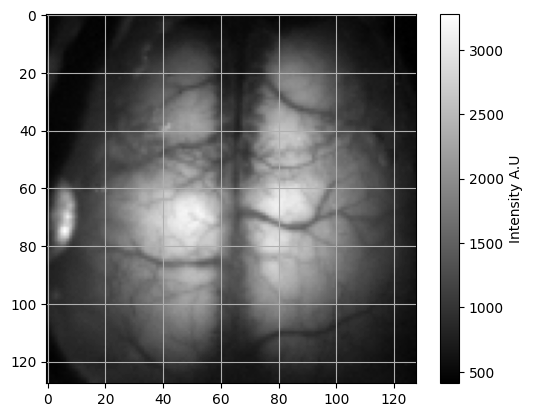

frame number 6000 plotted


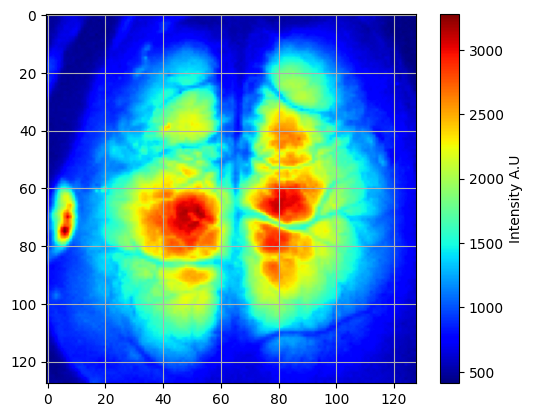

In [14]:
plot_frame(frames, frame_number, cmap = 'grey', color_label = "Intensity A.U")
plot_frame(frames, frame_number, cmap = 'jet', color_label = "Intensity A.U")

### 3B: Plot of the raw signal mean for each frame over the length of the experiment

Mean time course of the raw signal

In [15]:
mean_timecourse = temporal_mean(frames);

default 20% threshold is 404.734130859375 Determine if adjustments need to be made


## Step 4: Mean Timecourse without Darkframes at Start and End

#### 4A: plot of timecourse

#### 4B: number of single and double flashes as well as total number.

In [16]:
darkf_removed = remove_dark_frames(frames, mean_timecourse, 0.35)
darkf_removed_timecourse, darkf_removed_frames = darkf_removed[0], darkf_removed[1] #first one is the timecourse with no 3d, second is the 3d array

threshold determined to be: 455.3258972167969


#### 4C: pybaselines (only run if missing flashes)

In [17]:
if missing_artifacts == "TRUE":
    x = np.linspace(0, len(darkf_removed_timecourse), len(darkf_removed_timecourse))
    baseline_fitter = Baseline(x_data=x)

    smoothed_imodpoly = baseline_fitter.imodpoly(darkf_removed_timecourse, poly_order=3, num_std=0.7)[0]
    flattened = darkf_removed_timecourse-smoothed_imodpoly

    artifacts = extract_artifacts(flattened)
    artifact_indices, single_indices, double_indices = artifacts[0], artifacts[1], artifacts[2]

    #plotting moving mean and signal
    fig = px.line(y = [flattened])
    fig.update_layout(
    title= "mean timecourse with moving average overlay",
    xaxis=dict(title="frame number (30 fps)"),
    yaxis=dict(title="intensity value (A.U)"),
    xaxis_rangeslider_visible=True,
    showlegend=True)

    fig.for_each_trace(lambda t: t.update(name="Signal") if "0" in t.name else t.update(name="10s Moving Average"))

    fig.show()

    plt.figure()
    plt.plot(darkf_removed_timecourse, label='Subset Signal')
    plt.plot(smoothed_imodpoly, '--', label='Smoothed imodpoly')
    plt.legend()
    plt.show()

!! If the total does not match the single and double combined, check dataset!!

In [18]:
if missing_artifacts == "FALSE": #newv2
    artifacts = extract_artifacts(darkf_removed_timecourse)
    artifact_indices, single_indices, double_indices = artifacts[0], artifacts[1], artifacts[2]

Number of double_flash: 72
Number of double_flash pairs: 36
Number of single_flash: 38
Number of total flashes: 110


## Step 5: Artifact Removal and DFF

### 5A: Plot of mean timecourse with artifacts removed


plot is generated with interpolated frames where the artifacts were, approximately 5 frames

In [19]:
no_artifact_timecourse = interpolate(darkf_removed_frames, artifact_indices, 5)

interpolating artifact frames...


  0%|                                                                                          | 0/110 [00:00<?, ?it/s]

  1%|▋                                                                                 | 1/110 [00:01<02:30,  1.38s/it]

  2%|█▍                                                                                | 2/110 [00:02<02:28,  1.38s/it]

  3%|██▏                                                                               | 3/110 [00:04<02:33,  1.44s/it]

  4%|██▉                                                                               | 4/110 [00:05<02:23,  1.36s/it]

  5%|███▋                                                                              | 5/110 [00:06<02:15,  1.30s/it]

  5%|████▍                                                                             | 6/110 [00:07<02:14,  1.29s/it]

  6%|█████▏                                                                            | 7/110 [00:09<02:12,  1.29s/it]

  7%|█████▉                                                                            | 8/110 [00:10<02:16,  1.34s/it]

  8%|██████▋                                                                           | 9/110 [00:11<02:13,  1.32s/it]

  9%|███████▎                                                                         | 10/110 [00:13<02:09,  1.30s/it]

 10%|████████                                                                         | 11/110 [00:14<02:14,  1.35s/it]

 11%|████████▊                                                                        | 12/110 [00:16<02:12,  1.35s/it]

 12%|█████████▌                                                                       | 13/110 [00:17<02:07,  1.31s/it]

 13%|██████████▎                                                                      | 14/110 [00:18<02:02,  1.28s/it]

 14%|███████████                                                                      | 15/110 [00:19<01:59,  1.26s/it]

 15%|███████████▊                                                                     | 16/110 [00:21<02:04,  1.33s/it]

 15%|████████████▌                                                                    | 17/110 [00:22<02:04,  1.34s/it]

 16%|█████████████▎                                                                   | 18/110 [00:23<02:02,  1.34s/it]

 17%|█████████████▉                                                                   | 19/110 [00:25<01:58,  1.30s/it]

 18%|██████████████▋                                                                  | 20/110 [00:26<01:54,  1.27s/it]

 19%|███████████████▍                                                                 | 21/110 [00:27<01:57,  1.32s/it]

 20%|████████████████▏                                                                | 22/110 [00:29<01:57,  1.33s/it]

 21%|████████████████▉                                                                | 23/110 [00:30<01:53,  1.30s/it]

 22%|█████████████████▋                                                               | 24/110 [00:31<01:51,  1.30s/it]

 23%|██████████████████▍                                                              | 25/110 [00:32<01:52,  1.32s/it]

 24%|███████████████████▏                                                             | 26/110 [00:34<01:50,  1.32s/it]

 25%|███████████████████▉                                                             | 27/110 [00:35<01:48,  1.30s/it]

 25%|████████████████████▌                                                            | 28/110 [00:36<01:45,  1.29s/it]

 26%|█████████████████████▎                                                           | 29/110 [00:37<01:41,  1.26s/it]

 27%|██████████████████████                                                           | 30/110 [00:39<01:43,  1.30s/it]

 28%|██████████████████████▊                                                          | 31/110 [00:40<01:43,  1.32s/it]

 29%|███████████████████████▌                                                         | 32/110 [00:41<01:39,  1.28s/it]

 30%|████████████████████████▎                                                        | 33/110 [00:43<01:40,  1.31s/it]

 31%|█████████████████████████                                                        | 34/110 [00:44<01:39,  1.31s/it]

 32%|█████████████████████████▊                                                       | 35/110 [00:45<01:35,  1.28s/it]

 33%|██████████████████████████▌                                                      | 36/110 [00:47<01:35,  1.30s/it]

 34%|███████████████████████████▏                                                     | 37/110 [00:48<01:32,  1.27s/it]

 35%|███████████████████████████▉                                                     | 38/110 [00:49<01:29,  1.25s/it]

 35%|████████████████████████████▋                                                    | 39/110 [00:50<01:32,  1.30s/it]

 36%|█████████████████████████████▍                                                   | 40/110 [00:52<01:36,  1.38s/it]

 37%|██████████████████████████████▏                                                  | 41/110 [00:53<01:35,  1.39s/it]

 38%|██████████████████████████████▉                                                  | 42/110 [00:55<01:33,  1.38s/it]

 39%|███████████████████████████████▋                                                 | 43/110 [00:56<01:31,  1.36s/it]

 40%|████████████████████████████████▍                                                | 44/110 [00:57<01:26,  1.32s/it]

 41%|█████████████████████████████████▏                                               | 45/110 [00:59<01:26,  1.34s/it]

 42%|█████████████████████████████████▊                                               | 46/110 [01:00<01:27,  1.36s/it]

 43%|██████████████████████████████████▌                                              | 47/110 [01:02<01:26,  1.38s/it]

 44%|███████████████████████████████████▎                                             | 48/110 [01:03<01:25,  1.38s/it]

 45%|████████████████████████████████████                                             | 49/110 [01:04<01:21,  1.33s/it]

 45%|████████████████████████████████████▊                                            | 50/110 [01:06<01:21,  1.35s/it]

 46%|█████████████████████████████████████▌                                           | 51/110 [01:07<01:19,  1.34s/it]

 47%|██████████████████████████████████████▎                                          | 52/110 [01:08<01:18,  1.35s/it]

 48%|███████████████████████████████████████                                          | 53/110 [01:10<01:15,  1.33s/it]

 49%|███████████████████████████████████████▊                                         | 54/110 [01:11<01:15,  1.35s/it]

 50%|████████████████████████████████████████▌                                        | 55/110 [01:12<01:14,  1.35s/it]

 51%|█████████████████████████████████████████▏                                       | 56/110 [01:14<01:11,  1.33s/it]

 52%|█████████████████████████████████████████▉                                       | 57/110 [01:15<01:09,  1.31s/it]

 53%|██████████████████████████████████████████▋                                      | 58/110 [01:16<01:08,  1.31s/it]

 54%|███████████████████████████████████████████▍                                     | 59/110 [01:18<01:07,  1.33s/it]

 55%|████████████████████████████████████████████▏                                    | 60/110 [01:19<01:06,  1.33s/it]

 55%|████████████████████████████████████████████▉                                    | 61/110 [01:20<01:06,  1.35s/it]

 56%|█████████████████████████████████████████████▋                                   | 62/110 [01:22<01:04,  1.35s/it]

 57%|██████████████████████████████████████████████▍                                  | 63/110 [01:23<01:02,  1.33s/it]

 58%|███████████████████████████████████████████████▏                                 | 64/110 [01:24<01:00,  1.31s/it]

 59%|███████████████████████████████████████████████▊                                 | 65/110 [01:26<01:00,  1.35s/it]

 60%|████████████████████████████████████████████████▌                                | 66/110 [01:27<00:58,  1.33s/it]

 61%|█████████████████████████████████████████████████▎                               | 67/110 [01:28<00:56,  1.32s/it]

 62%|██████████████████████████████████████████████████                               | 68/110 [01:30<00:55,  1.33s/it]

 63%|██████████████████████████████████████████████████▊                              | 69/110 [01:31<00:53,  1.30s/it]

 64%|███████████████████████████████████████████████████▌                             | 70/110 [01:32<00:52,  1.31s/it]

 65%|████████████████████████████████████████████████████▎                            | 71/110 [01:33<00:52,  1.33s/it]

 65%|█████████████████████████████████████████████████████                            | 72/110 [01:35<00:48,  1.29s/it]

 66%|█████████████████████████████████████████████████████▊                           | 73/110 [01:36<00:47,  1.29s/it]

 67%|██████████████████████████████████████████████████████▍                          | 74/110 [01:37<00:47,  1.33s/it]

 68%|███████████████████████████████████████████████████████▏                         | 75/110 [01:39<00:46,  1.33s/it]

 69%|███████████████████████████████████████████████████████▉                         | 76/110 [01:40<00:46,  1.36s/it]

 70%|████████████████████████████████████████████████████████▋                        | 77/110 [01:42<00:44,  1.36s/it]

 71%|█████████████████████████████████████████████████████████▍                       | 78/110 [01:43<00:43,  1.37s/it]

 72%|██████████████████████████████████████████████████████████▏                      | 79/110 [01:44<00:40,  1.32s/it]

 73%|██████████████████████████████████████████████████████████▉                      | 80/110 [01:45<00:39,  1.30s/it]

 74%|███████████████████████████████████████████████████████████▋                     | 81/110 [01:47<00:37,  1.29s/it]

 75%|████████████████████████████████████████████████████████████▍                    | 82/110 [01:48<00:36,  1.30s/it]

 75%|█████████████████████████████████████████████████████████████                    | 83/110 [01:49<00:35,  1.31s/it]

 76%|█████████████████████████████████████████████████████████████▊                   | 84/110 [01:51<00:33,  1.31s/it]

 77%|██████████████████████████████████████████████████████████████▌                  | 85/110 [01:52<00:31,  1.26s/it]

 78%|███████████████████████████████████████████████████████████████▎                 | 86/110 [01:53<00:30,  1.27s/it]

 79%|████████████████████████████████████████████████████████████████                 | 87/110 [01:54<00:29,  1.28s/it]

 80%|████████████████████████████████████████████████████████████████▊                | 88/110 [01:56<00:28,  1.31s/it]

 81%|█████████████████████████████████████████████████████████████████▌               | 89/110 [01:57<00:27,  1.30s/it]

 82%|██████████████████████████████████████████████████████████████████▎              | 90/110 [01:58<00:26,  1.33s/it]

 83%|███████████████████████████████████████████████████████████████████              | 91/110 [02:00<00:25,  1.34s/it]

 84%|███████████████████████████████████████████████████████████████████▋             | 92/110 [02:01<00:23,  1.33s/it]

 85%|████████████████████████████████████████████████████████████████████▍            | 93/110 [02:02<00:22,  1.30s/it]

 85%|█████████████████████████████████████████████████████████████████████▏           | 94/110 [02:04<00:20,  1.29s/it]

 86%|█████████████████████████████████████████████████████████████████████▉           | 95/110 [02:05<00:19,  1.32s/it]

 87%|██████████████████████████████████████████████████████████████████████▋          | 96/110 [02:06<00:18,  1.32s/it]

 88%|███████████████████████████████████████████████████████████████████████▍         | 97/110 [02:07<00:16,  1.28s/it]

 89%|████████████████████████████████████████████████████████████████████████▏        | 98/110 [02:09<00:15,  1.28s/it]

 90%|████████████████████████████████████████████████████████████████████████▉        | 99/110 [02:10<00:13,  1.27s/it]

 91%|████████████████████████████████████████████████████████████████████████▋       | 100/110 [02:11<00:12,  1.30s/it]

 92%|█████████████████████████████████████████████████████████████████████████▍      | 101/110 [02:13<00:11,  1.27s/it]

 93%|██████████████████████████████████████████████████████████████████████████▏     | 102/110 [02:14<00:10,  1.29s/it]

 94%|██████████████████████████████████████████████████████████████████████████▉     | 103/110 [02:15<00:09,  1.30s/it]

 95%|███████████████████████████████████████████████████████████████████████████▋    | 104/110 [02:16<00:07,  1.25s/it]

 95%|████████████████████████████████████████████████████████████████████████████▎   | 105/110 [02:18<00:06,  1.25s/it]

 96%|█████████████████████████████████████████████████████████████████████████████   | 106/110 [02:19<00:05,  1.29s/it]

 97%|█████████████████████████████████████████████████████████████████████████████▊  | 107/110 [02:20<00:03,  1.29s/it]

 98%|██████████████████████████████████████████████████████████████████████████████▌ | 108/110 [02:21<00:02,  1.26s/it]

 99%|███████████████████████████████████████████████████████████████████████████████▎| 109/110 [02:23<00:01,  1.24s/it]

100%|████████████████████████████████████████████████████████████████████████████████| 110/110 [02:24<00:00,  1.25s/it]

100%|████████████████████████████████████████████████████████████████████████████████| 110/110 [02:24<00:00,  1.31s/it]

### 5B: Calculating dff


Dff calculated from the 3d array without artifacts, darkframes removed, and interpolated the space where the artifacts were. Then plotting of the signal with the 10s moving mean before dff is applied. dff is applied using this moving mean onto the signal

In [20]:
dff_array = dff(no_artifact_timecourse, 10, 30);
dff_signal, moving_average = dff_array[0], dff_array[1]

  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

 20%|███████████████▋                                                                | 25/128 [00:00<00:00, 245.18it/s]

 39%|███████████████████████████████▎                                                | 50/128 [00:00<00:00, 224.47it/s]

 57%|█████████████████████████████████████████████▋                                  | 73/128 [00:00<00:00, 223.04it/s]

 76%|████████████████████████████████████████████████████████████▋                   | 97/128 [00:00<00:00, 227.74it/s]

 97%|████████████████████████████████████████████████████████████████████████████▌  | 124/128 [00:00<00:00, 241.64it/s]

100%|███████████████████████████████████████████████████████████████████████████████| 128/128 [00:00<00:00, 235.37it/s]

  0%|                                                                                        | 0/34068 [00:00<?, ?it/s]

  0%|                                                                              | 23/34068 [00:00<02:30, 225.57it/s]

  0%|                                                                              | 46/34068 [00:00<02:45, 205.92it/s]

  0%|▏                                                                             | 67/34068 [00:00<02:54, 195.05it/s]

  0%|▏                                                                             | 97/34068 [00:00<02:27, 230.07it/s]

  0%|▎                                                                            | 122/34068 [00:00<02:24, 234.81it/s]

  0%|▎                                                                            | 146/34068 [00:00<02:25, 232.74it/s]

  1%|▍                                                                            | 174/34068 [00:00<02:17, 246.81it/s]

  1%|▍                                                                            | 199/34068 [00:00<02:18, 244.06it/s]

  1%|▌                                                                            | 224/34068 [00:00<02:18, 243.67it/s]

  1%|▌                                                                            | 249/34068 [00:01<02:19, 242.68it/s]

  1%|▌                                                                            | 274/34068 [00:01<02:18, 243.43it/s]

  1%|▋                                                                            | 299/34068 [00:01<02:20, 241.11it/s]

  1%|▋                                                                            | 324/34068 [00:01<02:24, 232.79it/s]

  1%|▊                                                                            | 349/34068 [00:01<02:22, 237.07it/s]

  1%|▊                                                                            | 373/34068 [00:01<02:28, 227.40it/s]

  1%|▉                                                                            | 397/34068 [00:01<02:27, 229.04it/s]

  1%|▉                                                                            | 425/34068 [00:01<02:19, 241.59it/s]

  1%|█                                                                            | 450/34068 [00:01<02:24, 232.63it/s]

  1%|█                                                                            | 474/34068 [00:02<02:29, 223.99it/s]

  1%|█▏                                                                           | 500/34068 [00:02<02:23, 233.37it/s]

  2%|█▏                                                                           | 524/34068 [00:02<02:28, 226.29it/s]

  2%|█▏                                                                           | 551/34068 [00:02<02:21, 236.58it/s]

  2%|█▎                                                                           | 576/34068 [00:02<02:20, 239.06it/s]

  2%|█▎                                                                           | 601/34068 [00:02<02:19, 240.16it/s]

  2%|█▍                                                                           | 627/34068 [00:02<02:16, 244.51it/s]

  2%|█▍                                                                           | 654/34068 [00:02<02:14, 249.06it/s]

  2%|█▌                                                                           | 681/34068 [00:02<02:11, 253.71it/s]

  2%|█▌                                                                           | 708/34068 [00:02<02:09, 257.00it/s]

  2%|█▋                                                                           | 735/34068 [00:03<02:08, 259.32it/s]

  2%|█▋                                                                           | 761/34068 [00:03<02:12, 252.13it/s]

  2%|█▊                                                                           | 787/34068 [00:03<02:11, 252.83it/s]

  2%|█▊                                                                           | 813/34068 [00:03<02:17, 241.21it/s]

  2%|█▉                                                                           | 841/34068 [00:03<02:13, 249.66it/s]

  3%|█▉                                                                           | 869/34068 [00:03<02:09, 255.43it/s]

  3%|██                                                                           | 896/34068 [00:03<02:08, 258.16it/s]

  3%|██                                                                           | 925/34068 [00:03<02:04, 265.88it/s]

  3%|██▏                                                                          | 952/34068 [00:03<02:11, 252.38it/s]

  3%|██▏                                                                          | 978/34068 [00:04<02:16, 242.24it/s]

  3%|██▏                                                                         | 1005/34068 [00:04<02:12, 249.28it/s]

  3%|██▎                                                                         | 1031/34068 [00:04<02:12, 248.81it/s]

  3%|██▎                                                                         | 1060/34068 [00:04<02:07, 259.11it/s]

  3%|██▍                                                                         | 1087/34068 [00:04<02:06, 261.52it/s]

  3%|██▍                                                                         | 1116/34068 [00:04<02:03, 267.51it/s]

  3%|██▌                                                                         | 1143/34068 [00:04<02:10, 251.38it/s]

  3%|██▌                                                                         | 1171/34068 [00:04<02:08, 256.57it/s]

  4%|██▋                                                                         | 1199/34068 [00:04<02:05, 261.76it/s]

  4%|██▋                                                                         | 1226/34068 [00:05<02:08, 254.64it/s]

  4%|██▊                                                                         | 1252/34068 [00:05<02:08, 254.74it/s]

  4%|██▊                                                                         | 1278/34068 [00:05<02:08, 255.54it/s]

  4%|██▉                                                                         | 1304/34068 [00:05<02:09, 253.91it/s]

  4%|██▉                                                                         | 1330/34068 [00:05<02:12, 247.78it/s]

  4%|███                                                                         | 1355/34068 [00:05<02:12, 247.73it/s]

  4%|███                                                                         | 1380/34068 [00:05<02:13, 245.56it/s]

  4%|███▏                                                                        | 1405/34068 [00:05<02:14, 241.95it/s]

  4%|███▏                                                                        | 1432/34068 [00:05<02:11, 247.94it/s]

  4%|███▎                                                                        | 1460/34068 [00:05<02:07, 256.54it/s]

  4%|███▎                                                                        | 1486/34068 [00:06<02:08, 253.86it/s]

  4%|███▍                                                                        | 1514/34068 [00:06<02:05, 258.50it/s]

  5%|███▍                                                                        | 1540/34068 [00:06<02:10, 249.50it/s]

  5%|███▍                                                                        | 1568/34068 [00:06<02:06, 256.06it/s]

  5%|███▌                                                                        | 1594/34068 [00:06<02:14, 241.50it/s]

  5%|███▌                                                                        | 1621/34068 [00:06<02:11, 247.03it/s]

  5%|███▋                                                                        | 1646/34068 [00:06<02:12, 244.97it/s]

  5%|███▋                                                                        | 1675/34068 [00:06<02:06, 256.39it/s]

  5%|███▊                                                                        | 1701/34068 [00:06<02:20, 231.01it/s]

  5%|███▊                                                                        | 1728/34068 [00:07<02:14, 239.62it/s]

  5%|███▉                                                                        | 1756/34068 [00:07<02:09, 248.76it/s]

  5%|███▉                                                                        | 1782/34068 [00:07<02:24, 223.05it/s]

  5%|████                                                                        | 1810/34068 [00:07<02:16, 235.56it/s]

  5%|████                                                                        | 1837/34068 [00:07<02:12, 242.93it/s]

  5%|████▏                                                                       | 1862/34068 [00:07<02:15, 238.31it/s]

  6%|████▏                                                                       | 1887/34068 [00:07<02:13, 240.25it/s]

  6%|████▎                                                                       | 1912/34068 [00:07<02:16, 235.04it/s]

  6%|████▎                                                                       | 1941/34068 [00:07<02:09, 247.74it/s]

  6%|████▍                                                                       | 1966/34068 [00:08<02:10, 246.31it/s]

  6%|████▍                                                                       | 1992/34068 [00:08<02:09, 248.13it/s]

  6%|████▌                                                                       | 2021/34068 [00:08<02:04, 258.02it/s]

  6%|████▌                                                                       | 2047/34068 [00:08<02:08, 248.51it/s]

  6%|████▋                                                                       | 2075/34068 [00:08<02:05, 255.33it/s]

  6%|████▋                                                                       | 2101/34068 [00:08<02:05, 254.51it/s]

  6%|████▋                                                                       | 2127/34068 [00:08<02:15, 235.03it/s]

  6%|████▊                                                                       | 2151/34068 [00:08<02:19, 228.26it/s]

  6%|████▊                                                                       | 2175/34068 [00:08<02:18, 230.24it/s]

  6%|████▉                                                                       | 2200/34068 [00:09<02:15, 234.50it/s]

  7%|████▉                                                                       | 2227/34068 [00:09<02:10, 243.96it/s]

  7%|█████                                                                       | 2253/34068 [00:09<02:09, 245.78it/s]

  7%|█████                                                                       | 2278/34068 [00:09<02:16, 232.50it/s]

  7%|█████▏                                                                      | 2304/34068 [00:09<02:13, 238.23it/s]

  7%|█████▏                                                                      | 2330/34068 [00:09<02:10, 243.65it/s]

  7%|█████▎                                                                      | 2355/34068 [00:09<02:22, 222.34it/s]

  7%|█████▎                                                                      | 2381/34068 [00:09<02:17, 230.71it/s]

  7%|█████▎                                                                      | 2408/34068 [00:09<02:11, 240.68it/s]

  7%|█████▍                                                                      | 2433/34068 [00:09<02:12, 238.96it/s]

  7%|█████▍                                                                      | 2458/34068 [00:10<02:16, 232.22it/s]

  7%|█████▌                                                                      | 2483/34068 [00:10<02:13, 235.90it/s]

  7%|█████▌                                                                      | 2510/34068 [00:10<02:08, 244.94it/s]

  7%|█████▋                                                                      | 2536/34068 [00:10<02:07, 247.17it/s]

  8%|█████▋                                                                      | 2561/34068 [00:10<02:12, 237.67it/s]

  8%|█████▊                                                                      | 2589/34068 [00:10<02:06, 249.03it/s]

  8%|█████▊                                                                      | 2618/34068 [00:10<02:01, 258.63it/s]

  8%|█████▉                                                                      | 2644/34068 [00:10<02:06, 247.57it/s]

  8%|█████▉                                                                      | 2671/34068 [00:10<02:03, 253.24it/s]

  8%|██████                                                                      | 2699/34068 [00:11<02:00, 259.47it/s]

  8%|██████                                                                      | 2727/34068 [00:11<01:59, 263.16it/s]

  8%|██████▏                                                                     | 2754/34068 [00:11<02:03, 254.08it/s]

  8%|██████▏                                                                     | 2780/34068 [00:11<02:04, 250.79it/s]

  8%|██████▎                                                                     | 2806/34068 [00:11<02:08, 243.04it/s]

  8%|██████▎                                                                     | 2831/34068 [00:11<02:12, 235.11it/s]

  8%|██████▎                                                                     | 2856/34068 [00:11<02:11, 236.64it/s]

  8%|██████▍                                                                     | 2880/34068 [00:11<02:13, 234.31it/s]

  9%|██████▍                                                                     | 2909/34068 [00:11<02:05, 248.76it/s]

  9%|██████▌                                                                     | 2934/34068 [00:12<02:08, 242.85it/s]

  9%|██████▌                                                                     | 2959/34068 [00:12<02:08, 242.15it/s]

  9%|██████▋                                                                     | 2984/34068 [00:12<02:11, 236.93it/s]

  9%|██████▋                                                                     | 3008/34068 [00:12<02:13, 231.91it/s]

  9%|██████▊                                                                     | 3032/34068 [00:12<02:18, 223.80it/s]

  9%|██████▊                                                                     | 3058/34068 [00:12<02:14, 231.35it/s]

  9%|██████▉                                                                     | 3086/34068 [00:12<02:07, 243.08it/s]

  9%|██████▉                                                                     | 3111/34068 [00:12<02:07, 243.00it/s]

  9%|███████                                                                     | 3138/34068 [00:12<02:04, 248.66it/s]

  9%|███████                                                                     | 3166/34068 [00:12<02:00, 255.56it/s]

  9%|███████                                                                     | 3192/34068 [00:13<02:02, 251.03it/s]

  9%|███████▏                                                                    | 3218/34068 [00:13<02:03, 250.03it/s]

 10%|███████▏                                                                    | 3245/34068 [00:13<02:01, 254.36it/s]

 10%|███████▎                                                                    | 3271/34068 [00:13<02:04, 246.69it/s]

 10%|███████▎                                                                    | 3296/34068 [00:13<02:10, 236.17it/s]

 10%|███████▍                                                                    | 3323/34068 [00:13<02:05, 244.32it/s]

 10%|███████▍                                                                    | 3350/34068 [00:13<02:03, 249.53it/s]

 10%|███████▌                                                                    | 3377/34068 [00:13<02:01, 253.25it/s]

 10%|███████▌                                                                    | 3403/34068 [00:13<02:06, 243.26it/s]

 10%|███████▋                                                                    | 3428/34068 [00:14<02:12, 231.04it/s]

 10%|███████▋                                                                    | 3456/34068 [00:14<02:06, 241.89it/s]

 10%|███████▊                                                                    | 3482/34068 [00:14<02:04, 246.41it/s]

 10%|███████▊                                                                    | 3507/34068 [00:14<02:06, 242.19it/s]

 10%|███████▉                                                                    | 3533/34068 [00:14<02:04, 245.41it/s]

 10%|███████▉                                                                    | 3560/34068 [00:14<02:01, 251.79it/s]

 11%|████████                                                                    | 3587/34068 [00:14<01:59, 255.63it/s]

 11%|████████                                                                    | 3613/34068 [00:14<02:07, 239.43it/s]

 11%|████████                                                                    | 3639/34068 [00:14<02:05, 242.50it/s]

 11%|████████▏                                                                   | 3667/34068 [00:15<02:01, 251.02it/s]

 11%|████████▏                                                                   | 3693/34068 [00:15<02:00, 252.90it/s]

 11%|████████▎                                                                   | 3720/34068 [00:15<01:58, 257.14it/s]

 11%|████████▎                                                                   | 3746/34068 [00:15<02:11, 230.97it/s]

 11%|████████▍                                                                   | 3771/34068 [00:15<02:09, 233.62it/s]

 11%|████████▍                                                                   | 3798/34068 [00:15<02:05, 241.19it/s]

 11%|████████▌                                                                   | 3823/34068 [00:15<02:06, 239.65it/s]

 11%|████████▌                                                                   | 3848/34068 [00:15<02:09, 233.98it/s]

 11%|████████▋                                                                   | 3875/34068 [00:15<02:03, 243.84it/s]

 11%|████████▋                                                                   | 3904/34068 [00:15<01:58, 255.43it/s]

 12%|████████▊                                                                   | 3933/34068 [00:16<01:54, 263.92it/s]

 12%|████████▊                                                                   | 3962/34068 [00:16<01:51, 269.71it/s]

 12%|████████▉                                                                   | 3990/34068 [00:16<02:00, 250.09it/s]

 12%|████████▉                                                                   | 4016/34068 [00:16<02:10, 229.95it/s]

 12%|█████████                                                                   | 4040/34068 [00:16<02:16, 220.38it/s]

 12%|█████████                                                                   | 4065/34068 [00:16<02:12, 227.02it/s]

 12%|█████████                                                                   | 4089/34068 [00:16<02:12, 226.26it/s]

 12%|█████████▏                                                                  | 4116/34068 [00:16<02:06, 236.42it/s]

 12%|█████████▏                                                                  | 4140/34068 [00:17<02:11, 228.45it/s]

 12%|█████████▎                                                                  | 4166/34068 [00:17<02:07, 235.30it/s]

 12%|█████████▎                                                                  | 4190/34068 [00:17<02:13, 223.97it/s]

 12%|█████████▍                                                                  | 4214/34068 [00:17<02:11, 226.55it/s]

 12%|█████████▍                                                                  | 4239/34068 [00:17<02:09, 231.22it/s]

 13%|█████████▌                                                                  | 4263/34068 [00:17<02:11, 226.01it/s]

 13%|█████████▌                                                                  | 4286/34068 [00:17<02:17, 217.33it/s]

 13%|█████████▌                                                                  | 4314/34068 [00:17<02:07, 233.52it/s]

 13%|█████████▋                                                                  | 4343/34068 [00:17<02:00, 247.46it/s]

 13%|█████████▋                                                                  | 4368/34068 [00:17<02:01, 245.40it/s]

 13%|█████████▊                                                                  | 4393/34068 [00:18<02:02, 242.56it/s]

 13%|█████████▊                                                                  | 4422/34068 [00:18<01:56, 254.73it/s]

 13%|█████████▉                                                                  | 4448/34068 [00:18<02:05, 235.80it/s]

 13%|█████████▉                                                                  | 4474/34068 [00:18<02:02, 241.36it/s]

 13%|██████████                                                                  | 4499/34068 [00:18<02:01, 242.83it/s]

 13%|██████████                                                                  | 4526/34068 [00:18<01:58, 249.21it/s]

 13%|██████████▏                                                                 | 4555/34068 [00:18<01:54, 258.78it/s]

 13%|██████████▏                                                                 | 4584/34068 [00:18<01:50, 266.33it/s]

 14%|██████████▎                                                                 | 4611/34068 [00:18<01:50, 265.88it/s]

 14%|██████████▎                                                                 | 4640/34068 [00:19<01:48, 270.60it/s]

 14%|██████████▍                                                                 | 4668/34068 [00:19<01:51, 263.34it/s]

 14%|██████████▍                                                                 | 4695/34068 [00:19<01:55, 253.61it/s]

 14%|██████████▌                                                                 | 4721/34068 [00:19<02:00, 243.75it/s]

 14%|██████████▌                                                                 | 4746/34068 [00:19<02:01, 240.83it/s]

 14%|██████████▋                                                                 | 4771/34068 [00:19<02:02, 240.06it/s]

 14%|██████████▋                                                                 | 4797/34068 [00:19<01:59, 245.03it/s]

 14%|██████████▊                                                                 | 4822/34068 [00:19<02:01, 240.27it/s]

 14%|██████████▊                                                                 | 4847/34068 [00:19<02:01, 239.65it/s]

 14%|██████████▉                                                                 | 4876/34068 [00:19<01:55, 251.96it/s]

 14%|██████████▉                                                                 | 4905/34068 [00:20<01:51, 260.72it/s]

 14%|███████████                                                                 | 4934/34068 [00:20<01:48, 267.70it/s]

 15%|███████████                                                                 | 4963/34068 [00:20<01:47, 271.86it/s]

 15%|███████████▏                                                                | 4992/34068 [00:20<01:47, 271.63it/s]

 15%|███████████▏                                                                | 5020/34068 [00:20<01:46, 273.29it/s]

 15%|███████████▎                                                                | 5049/34068 [00:20<01:45, 275.79it/s]

 15%|███████████▎                                                                | 5077/34068 [00:20<01:52, 258.85it/s]

 15%|███████████▍                                                                | 5104/34068 [00:20<01:50, 261.27it/s]

 15%|███████████▍                                                                | 5131/34068 [00:20<01:50, 263.04it/s]

 15%|███████████▌                                                                | 5158/34068 [00:21<01:51, 258.35it/s]

 15%|███████████▌                                                                | 5185/34068 [00:21<01:51, 258.02it/s]

 15%|███████████▌                                                                | 5211/34068 [00:21<01:57, 246.54it/s]

 15%|███████████▋                                                                | 5238/34068 [00:21<01:53, 252.90it/s]

 15%|███████████▋                                                                | 5264/34068 [00:21<01:58, 243.39it/s]

 16%|███████████▊                                                                | 5290/34068 [00:21<01:57, 245.93it/s]

 16%|███████████▊                                                                | 5315/34068 [00:21<01:58, 241.66it/s]

 16%|███████████▉                                                                | 5340/34068 [00:21<02:03, 232.17it/s]

 16%|███████████▉                                                                | 5367/34068 [00:21<01:58, 241.64it/s]

 16%|████████████                                                                | 5392/34068 [00:22<02:00, 237.96it/s]

 16%|████████████                                                                | 5417/34068 [00:22<01:59, 240.72it/s]

 16%|████████████▏                                                               | 5445/34068 [00:22<01:53, 251.32it/s]

 16%|████████████▏                                                               | 5473/34068 [00:22<01:51, 257.44it/s]

 16%|████████████▎                                                               | 5501/34068 [00:22<01:48, 263.28it/s]

 16%|████████████▎                                                               | 5528/34068 [00:22<01:49, 260.69it/s]

 16%|████████████▍                                                               | 5556/34068 [00:22<01:47, 265.57it/s]

 16%|████████████▍                                                               | 5584/34068 [00:22<01:46, 267.48it/s]

 16%|████████████▌                                                               | 5611/34068 [00:22<01:47, 265.13it/s]

 17%|████████████▌                                                               | 5638/34068 [00:22<01:48, 262.73it/s]

 17%|████████████▋                                                               | 5665/34068 [00:23<01:47, 263.34it/s]

 17%|████████████▋                                                               | 5692/34068 [00:23<01:49, 259.99it/s]

 17%|████████████▊                                                               | 5719/34068 [00:23<01:56, 243.77it/s]

 17%|████████████▊                                                               | 5747/34068 [00:23<01:51, 253.17it/s]

 17%|████████████▉                                                               | 5776/34068 [00:23<01:47, 262.17it/s]

 17%|████████████▉                                                               | 5805/34068 [00:23<01:45, 268.65it/s]

 17%|█████████████                                                               | 5833/34068 [00:23<01:52, 251.55it/s]

 17%|█████████████                                                               | 5859/34068 [00:23<01:52, 250.45it/s]

 17%|█████████████▏                                                              | 5885/34068 [00:23<01:55, 243.58it/s]

 17%|█████████████▏                                                              | 5913/34068 [00:24<01:51, 251.64it/s]

 17%|█████████████▎                                                              | 5941/34068 [00:24<01:49, 257.51it/s]

 18%|█████████████▎                                                              | 5968/34068 [00:24<01:47, 260.36it/s]

 18%|█████████████▎                                                              | 5995/34068 [00:24<01:52, 250.16it/s]

 18%|█████████████▍                                                              | 6021/34068 [00:24<01:51, 251.11it/s]

 18%|█████████████▍                                                              | 6048/34068 [00:24<01:50, 254.25it/s]

 18%|█████████████▌                                                              | 6074/34068 [00:24<01:51, 250.44it/s]

 18%|█████████████▌                                                              | 6100/34068 [00:24<01:54, 244.78it/s]

 18%|█████████████▋                                                              | 6125/34068 [00:24<02:02, 229.04it/s]

 18%|█████████████▋                                                              | 6149/34068 [00:25<02:02, 228.00it/s]

 18%|█████████████▊                                                              | 6172/34068 [00:25<02:02, 227.94it/s]

 18%|█████████████▊                                                              | 6199/34068 [00:25<01:57, 237.20it/s]

 18%|█████████████▉                                                              | 6223/34068 [00:25<02:03, 225.76it/s]

 18%|█████████████▉                                                              | 6246/34068 [00:25<02:04, 222.61it/s]

 18%|█████████████▉                                                              | 6270/34068 [00:25<02:02, 226.89it/s]

 18%|██████████████                                                              | 6299/34068 [00:25<01:54, 242.88it/s]

 19%|██████████████                                                              | 6324/34068 [00:25<01:56, 237.43it/s]

 19%|██████████████▏                                                             | 6351/34068 [00:25<01:53, 243.28it/s]

 19%|██████████████▏                                                             | 6376/34068 [00:25<01:54, 242.45it/s]

 19%|██████████████▎                                                             | 6404/34068 [00:26<01:49, 252.57it/s]

 19%|██████████████▎                                                             | 6431/34068 [00:26<01:47, 256.18it/s]

 19%|██████████████▍                                                             | 6457/34068 [00:26<01:52, 245.82it/s]

 19%|██████████████▍                                                             | 6482/34068 [00:26<01:51, 246.33it/s]

 19%|██████████████▌                                                             | 6507/34068 [00:26<01:52, 245.99it/s]

 19%|██████████████▌                                                             | 6532/34068 [00:26<01:53, 243.64it/s]

 19%|██████████████▋                                                             | 6558/34068 [00:26<01:51, 247.70it/s]

 19%|██████████████▋                                                             | 6586/34068 [00:26<01:47, 254.94it/s]

 19%|██████████████▊                                                             | 6612/34068 [00:26<01:53, 242.92it/s]

 19%|██████████████▊                                                             | 6637/34068 [00:27<01:55, 238.19it/s]

 20%|██████████████▊                                                             | 6661/34068 [00:27<01:58, 230.89it/s]

 20%|██████████████▉                                                             | 6689/34068 [00:27<01:52, 243.35it/s]

 20%|██████████████▉                                                             | 6714/34068 [00:27<01:56, 235.48it/s]

 20%|███████████████                                                             | 6738/34068 [00:27<01:55, 235.77it/s]

 20%|███████████████                                                             | 6762/34068 [00:27<01:57, 232.35it/s]

 20%|███████████████▏                                                            | 6786/34068 [00:27<01:58, 229.96it/s]

 20%|███████████████▏                                                            | 6810/34068 [00:27<01:58, 230.22it/s]

 20%|███████████████▎                                                            | 6839/34068 [00:27<01:50, 245.33it/s]

 20%|███████████████▎                                                            | 6868/34068 [00:27<01:46, 256.06it/s]

 20%|███████████████▍                                                            | 6897/34068 [00:28<01:43, 263.66it/s]

 20%|███████████████▍                                                            | 6926/34068 [00:28<01:40, 269.02it/s]

 20%|███████████████▌                                                            | 6953/34068 [00:28<01:45, 255.87it/s]

 20%|███████████████▌                                                            | 6979/34068 [00:28<01:47, 252.05it/s]

 21%|███████████████▋                                                            | 7005/34068 [00:28<01:47, 252.90it/s]

 21%|███████████████▋                                                            | 7031/34068 [00:28<01:51, 243.07it/s]

 21%|███████████████▋                                                            | 7056/34068 [00:28<01:51, 241.64it/s]

 21%|███████████████▊                                                            | 7085/34068 [00:28<01:46, 253.97it/s]

 21%|███████████████▊                                                            | 7111/34068 [00:28<01:46, 252.82it/s]

 21%|███████████████▉                                                            | 7137/34068 [00:29<01:46, 252.01it/s]

 21%|███████████████▉                                                            | 7166/34068 [00:29<01:42, 261.52it/s]

 21%|████████████████                                                            | 7193/34068 [00:29<01:43, 258.70it/s]

 21%|████████████████                                                            | 7220/34068 [00:29<01:43, 260.53it/s]

 21%|████████████████▏                                                           | 7248/34068 [00:29<01:41, 265.46it/s]

 21%|████████████████▏                                                           | 7275/34068 [00:29<01:44, 255.57it/s]

 21%|████████████████▎                                                           | 7301/34068 [00:29<01:45, 253.95it/s]

 22%|████████████████▎                                                           | 7327/34068 [00:29<01:46, 252.09it/s]

 22%|████████████████▍                                                           | 7354/34068 [00:29<01:44, 255.08it/s]

 22%|████████████████▍                                                           | 7380/34068 [00:29<01:45, 252.14it/s]

 22%|████████████████▌                                                           | 7407/34068 [00:30<01:43, 256.59it/s]

 22%|████████████████▌                                                           | 7433/34068 [00:30<01:45, 253.18it/s]

 22%|████████████████▋                                                           | 7460/34068 [00:30<01:43, 256.60it/s]

 22%|████████████████▋                                                           | 7489/34068 [00:30<01:40, 264.08it/s]

 22%|████████████████▊                                                           | 7518/34068 [00:30<01:38, 270.89it/s]

 22%|████████████████▊                                                           | 7547/34068 [00:30<01:37, 273.32it/s]

 22%|████████████████▉                                                           | 7575/34068 [00:30<01:39, 267.05it/s]

 22%|████████████████▉                                                           | 7602/34068 [00:30<01:39, 264.86it/s]

 22%|█████████████████                                                           | 7629/34068 [00:30<01:41, 260.34it/s]

 22%|█████████████████                                                           | 7657/34068 [00:31<01:40, 263.00it/s]

 23%|█████████████████▏                                                          | 7684/34068 [00:31<01:41, 259.06it/s]

 23%|█████████████████▏                                                          | 7712/34068 [00:31<01:40, 262.09it/s]

 23%|█████████████████▎                                                          | 7740/34068 [00:31<01:39, 265.00it/s]

 23%|█████████████████▎                                                          | 7769/34068 [00:31<01:37, 269.16it/s]

 23%|█████████████████▍                                                          | 7796/34068 [00:31<01:39, 264.81it/s]

 23%|█████████████████▍                                                          | 7824/34068 [00:31<01:38, 267.69it/s]

 23%|█████████████████▌                                                          | 7853/34068 [00:31<01:36, 272.63it/s]

 23%|█████████████████▌                                                          | 7881/34068 [00:31<01:37, 269.30it/s]

 23%|█████████████████▋                                                          | 7908/34068 [00:31<01:38, 264.91it/s]

 23%|█████████████████▋                                                          | 7936/34068 [00:32<01:37, 268.53it/s]

 23%|█████████████████▊                                                          | 7964/34068 [00:32<01:36, 270.33it/s]

 23%|█████████████████▊                                                          | 7992/34068 [00:32<01:37, 266.17it/s]

 24%|█████████████████▉                                                          | 8019/34068 [00:32<01:38, 265.00it/s]

 24%|█████████████████▉                                                          | 8046/34068 [00:32<01:38, 263.41it/s]

 24%|██████████████████                                                          | 8075/34068 [00:32<01:36, 268.06it/s]

 24%|██████████████████                                                          | 8102/34068 [00:32<01:38, 263.28it/s]

 24%|██████████████████▏                                                         | 8129/34068 [00:32<01:38, 264.49it/s]

 24%|██████████████████▏                                                         | 8157/34068 [00:32<01:36, 267.48it/s]

 24%|██████████████████▎                                                         | 8187/34068 [00:33<01:34, 273.84it/s]

 24%|██████████████████▎                                                         | 8215/34068 [00:33<01:34, 272.48it/s]

 24%|██████████████████▍                                                         | 8244/34068 [00:33<01:33, 275.22it/s]

 24%|██████████████████▍                                                         | 8272/34068 [00:33<01:34, 274.23it/s]

 24%|██████████████████▌                                                         | 8300/34068 [00:33<01:35, 270.15it/s]

 24%|██████████████████▌                                                         | 8329/34068 [00:33<01:33, 274.75it/s]

 25%|██████████████████▋                                                         | 8357/34068 [00:33<01:33, 275.50it/s]

 25%|██████████████████▋                                                         | 8385/34068 [00:33<01:34, 272.84it/s]

 25%|██████████████████▊                                                         | 8413/34068 [00:33<01:35, 269.44it/s]

 25%|██████████████████▊                                                         | 8441/34068 [00:33<01:34, 270.18it/s]

 25%|██████████████████▉                                                         | 8471/34068 [00:34<01:32, 275.69it/s]

 25%|██████████████████▉                                                         | 8499/34068 [00:34<01:36, 266.11it/s]

 25%|███████████████████                                                         | 8526/34068 [00:34<01:37, 262.00it/s]

 25%|███████████████████                                                         | 8555/34068 [00:34<01:34, 269.27it/s]

 25%|███████████████████▏                                                        | 8582/34068 [00:34<01:36, 264.90it/s]

 25%|███████████████████▏                                                        | 8610/34068 [00:34<01:34, 268.52it/s]

 25%|███████████████████▎                                                        | 8637/34068 [00:34<01:35, 265.87it/s]

 25%|███████████████████▎                                                        | 8664/34068 [00:34<01:37, 261.01it/s]

 26%|███████████████████▍                                                        | 8691/34068 [00:34<01:43, 245.19it/s]

 26%|███████████████████▍                                                        | 8716/34068 [00:35<01:45, 239.87it/s]

 26%|███████████████████▍                                                        | 8741/34068 [00:35<01:45, 240.73it/s]

 26%|███████████████████▌                                                        | 8770/34068 [00:35<01:40, 251.84it/s]

 26%|███████████████████▌                                                        | 8796/34068 [00:35<01:40, 252.04it/s]

 26%|███████████████████▋                                                        | 8822/34068 [00:35<01:39, 253.63it/s]

 26%|███████████████████▋                                                        | 8848/34068 [00:35<01:39, 252.57it/s]

 26%|███████████████████▊                                                        | 8874/34068 [00:35<01:51, 225.82it/s]

 26%|███████████████████▊                                                        | 8898/34068 [00:35<01:49, 229.05it/s]

 26%|███████████████████▉                                                        | 8925/34068 [00:35<01:45, 238.45it/s]

 26%|███████████████████▉                                                        | 8953/34068 [00:36<01:41, 247.40it/s]

 26%|████████████████████                                                        | 8980/34068 [00:36<01:39, 253.15it/s]

 26%|████████████████████                                                        | 9006/34068 [00:36<01:43, 243.21it/s]

 27%|████████████████████▏                                                       | 9031/34068 [00:36<01:47, 233.32it/s]

 27%|████████████████████▏                                                       | 9057/34068 [00:36<01:44, 240.08it/s]

 27%|████████████████████▎                                                       | 9084/34068 [00:36<01:41, 246.77it/s]

 27%|████████████████████▎                                                       | 9109/34068 [00:36<01:41, 245.69it/s]

 27%|████████████████████▍                                                       | 9137/34068 [00:36<01:38, 253.43it/s]

 27%|████████████████████▍                                                       | 9163/34068 [00:36<01:43, 240.36it/s]

 27%|████████████████████▍                                                       | 9188/34068 [00:36<01:44, 237.75it/s]

 27%|████████████████████▌                                                       | 9213/34068 [00:37<01:43, 239.20it/s]

 27%|████████████████████▌                                                       | 9238/34068 [00:37<01:52, 219.74it/s]

 27%|████████████████████▋                                                       | 9261/34068 [00:37<01:52, 219.57it/s]

 27%|████████████████████▋                                                       | 9288/34068 [00:37<01:46, 232.21it/s]

 27%|████████████████████▊                                                       | 9317/34068 [00:37<01:40, 246.41it/s]

 27%|████████████████████▊                                                       | 9344/34068 [00:37<01:38, 251.02it/s]

 28%|████████████████████▉                                                       | 9372/34068 [00:37<01:35, 258.63it/s]

 28%|████████████████████▉                                                       | 9399/34068 [00:37<01:38, 249.63it/s]

 28%|█████████████████████                                                       | 9425/34068 [00:37<01:38, 249.76it/s]

 28%|█████████████████████                                                       | 9452/34068 [00:38<01:36, 254.85it/s]

 28%|█████████████████████▏                                                      | 9478/34068 [00:38<01:38, 250.56it/s]

 28%|█████████████████████▏                                                      | 9504/34068 [00:38<01:40, 243.49it/s]

 28%|█████████████████████▎                                                      | 9532/34068 [00:38<01:36, 253.14it/s]

 28%|█████████████████████▎                                                      | 9558/34068 [00:38<01:41, 240.61it/s]

 28%|█████████████████████▍                                                      | 9583/34068 [00:38<01:46, 229.78it/s]

 28%|█████████████████████▍                                                      | 9609/34068 [00:38<01:43, 237.43it/s]

 28%|█████████████████████▍                                                      | 9633/34068 [00:38<01:46, 229.79it/s]

 28%|█████████████████████▌                                                      | 9657/34068 [00:38<01:45, 232.01it/s]

 28%|█████████████████████▌                                                      | 9681/34068 [00:39<01:44, 232.98it/s]

 28%|█████████████████████▋                                                      | 9708/34068 [00:39<01:40, 242.96it/s]

 29%|█████████████████████▋                                                      | 9734/34068 [00:39<01:39, 245.79it/s]

 29%|█████████████████████▊                                                      | 9763/34068 [00:39<01:34, 256.09it/s]

 29%|█████████████████████▊                                                      | 9790/34068 [00:39<01:33, 259.71it/s]

 29%|█████████████████████▉                                                      | 9819/34068 [00:39<01:30, 266.59it/s]

 29%|█████████████████████▉                                                      | 9846/34068 [00:39<01:42, 236.83it/s]

 29%|██████████████████████                                                      | 9871/34068 [00:39<01:50, 219.48it/s]

 29%|██████████████████████                                                      | 9894/34068 [00:39<01:49, 221.08it/s]

 29%|██████████████████████▏                                                     | 9921/34068 [00:40<01:43, 233.99it/s]

 29%|██████████████████████▏                                                     | 9948/34068 [00:40<01:39, 242.85it/s]

 29%|██████████████████████▎                                                     | 9974/34068 [00:40<01:38, 244.96it/s]

 29%|██████████████████████                                                     | 10001/34068 [00:40<01:36, 249.30it/s]

 29%|██████████████████████                                                     | 10027/34068 [00:40<01:36, 250.24it/s]

 30%|██████████████████████▏                                                    | 10053/34068 [00:40<01:41, 236.01it/s]

 30%|██████████████████████▏                                                    | 10081/34068 [00:40<01:37, 246.22it/s]

 30%|██████████████████████▎                                                    | 10109/34068 [00:40<01:34, 253.65it/s]

 30%|██████████████████████▎                                                    | 10137/34068 [00:40<01:32, 259.73it/s]

 30%|██████████████████████▍                                                    | 10164/34068 [00:40<01:34, 251.81it/s]

 30%|██████████████████████▍                                                    | 10190/34068 [00:41<01:34, 252.01it/s]

 30%|██████████████████████▍                                                    | 10218/34068 [00:41<01:32, 257.11it/s]

 30%|██████████████████████▌                                                    | 10245/34068 [00:41<01:31, 259.35it/s]

 30%|██████████████████████▌                                                    | 10272/34068 [00:41<01:33, 255.79it/s]

 30%|██████████████████████▋                                                    | 10298/34068 [00:41<01:33, 255.55it/s]

 30%|██████████████████████▋                                                    | 10324/34068 [00:41<01:33, 253.92it/s]

 30%|██████████████████████▊                                                    | 10350/34068 [00:41<01:34, 251.33it/s]

 30%|██████████████████████▊                                                    | 10376/34068 [00:41<01:36, 245.33it/s]

 31%|██████████████████████▉                                                    | 10404/34068 [00:41<01:33, 253.10it/s]

 31%|██████████████████████▉                                                    | 10432/34068 [00:42<01:31, 257.17it/s]

 31%|███████████████████████                                                    | 10462/34068 [00:42<01:28, 267.25it/s]

 31%|███████████████████████                                                    | 10491/34068 [00:42<01:26, 273.09it/s]

 31%|███████████████████████▏                                                   | 10519/34068 [00:42<01:27, 268.08it/s]

 31%|███████████████████████▏                                                   | 10546/34068 [00:42<01:31, 255.92it/s]

 31%|███████████████████████▎                                                   | 10575/34068 [00:42<01:29, 262.61it/s]

 31%|███████████████████████▎                                                   | 10605/34068 [00:42<01:26, 271.24it/s]

 31%|███████████████████████▍                                                   | 10633/34068 [00:42<01:29, 263.18it/s]

 31%|███████████████████████▍                                                   | 10660/34068 [00:42<01:36, 242.46it/s]

 31%|███████████████████████▌                                                   | 10685/34068 [00:43<01:38, 236.23it/s]

 31%|███████████████████████▌                                                   | 10713/34068 [00:43<01:35, 245.47it/s]

 32%|███████████████████████▋                                                   | 10740/34068 [00:43<01:32, 251.60it/s]

 32%|███████████████████████▋                                                   | 10766/34068 [00:43<01:33, 249.76it/s]

 32%|███████████████████████▊                                                   | 10792/34068 [00:43<01:33, 248.46it/s]

 32%|███████████████████████▊                                                   | 10820/34068 [00:43<01:31, 255.30it/s]

 32%|███████████████████████▉                                                   | 10846/34068 [00:43<01:35, 243.36it/s]

 32%|███████████████████████▉                                                   | 10872/34068 [00:43<01:33, 247.36it/s]

 32%|███████████████████████▉                                                   | 10899/34068 [00:43<01:32, 251.70it/s]

 32%|████████████████████████                                                   | 10925/34068 [00:44<01:41, 229.04it/s]

 32%|████████████████████████                                                   | 10949/34068 [00:44<01:41, 228.32it/s]

 32%|████████████████████████▏                                                  | 10978/34068 [00:44<01:34, 243.33it/s]

 32%|████████████████████████▏                                                  | 11005/34068 [00:44<01:32, 248.75it/s]

 32%|████████████████████████▎                                                  | 11032/34068 [00:44<01:30, 254.10it/s]

 32%|████████████████████████▎                                                  | 11059/34068 [00:44<01:29, 257.97it/s]

 33%|████████████████████████▍                                                  | 11087/34068 [00:44<01:27, 261.37it/s]

 33%|████████████████████████▍                                                  | 11115/34068 [00:44<01:26, 264.51it/s]

 33%|████████████████████████▌                                                  | 11143/34068 [00:44<01:25, 266.73it/s]

 33%|████████████████████████▌                                                  | 11171/34068 [00:44<01:25, 268.28it/s]

 33%|████████████████████████▋                                                  | 11199/34068 [00:45<01:24, 270.16it/s]

 33%|████████████████████████▋                                                  | 11227/34068 [00:45<01:26, 263.78it/s]

 33%|████████████████████████▊                                                  | 11254/34068 [00:45<01:30, 252.49it/s]

 33%|████████████████████████▊                                                  | 11280/34068 [00:45<01:32, 245.75it/s]

 33%|████████████████████████▉                                                  | 11308/34068 [00:45<01:29, 254.76it/s]

 33%|████████████████████████▉                                                  | 11336/34068 [00:45<01:27, 259.03it/s]

 33%|█████████████████████████                                                  | 11364/34068 [00:45<01:25, 264.31it/s]

 33%|█████████████████████████                                                  | 11391/34068 [00:45<01:25, 265.62it/s]

 34%|█████████████████████████▏                                                 | 11419/34068 [00:45<01:24, 268.29it/s]

 34%|█████████████████████████▏                                                 | 11447/34068 [00:45<01:23, 269.38it/s]

 34%|█████████████████████████▎                                                 | 11474/34068 [00:46<01:30, 249.10it/s]

 34%|█████████████████████████▎                                                 | 11500/34068 [00:46<01:31, 245.32it/s]

 34%|█████████████████████████▍                                                 | 11528/34068 [00:46<01:28, 253.62it/s]

 34%|█████████████████████████▍                                                 | 11554/34068 [00:46<01:30, 249.78it/s]

 34%|█████████████████████████▍                                                 | 11583/34068 [00:46<01:26, 259.03it/s]

 34%|█████████████████████████▌                                                 | 11612/34068 [00:46<01:24, 265.66it/s]

 34%|█████████████████████████▋                                                 | 11641/34068 [00:46<01:22, 271.16it/s]

 34%|█████████████████████████▋                                                 | 11669/34068 [00:46<01:27, 256.58it/s]

 34%|█████████████████████████▋                                                 | 11696/34068 [00:46<01:26, 259.64it/s]

 34%|█████████████████████████▊                                                 | 11725/34068 [00:47<01:23, 266.06it/s]

 35%|█████████████████████████▉                                                 | 11754/34068 [00:47<01:22, 270.64it/s]

 35%|█████████████████████████▉                                                 | 11782/34068 [00:47<01:21, 271.80it/s]

 35%|██████████████████████████                                                 | 11811/34068 [00:47<01:20, 275.53it/s]

 35%|██████████████████████████                                                 | 11839/34068 [00:47<01:27, 253.83it/s]

 35%|██████████████████████████                                                 | 11866/34068 [00:47<01:26, 255.50it/s]

 35%|██████████████████████████▏                                                | 11892/34068 [00:47<01:30, 245.73it/s]

 35%|██████████████████████████▏                                                | 11917/34068 [00:47<01:31, 242.23it/s]

 35%|██████████████████████████▎                                                | 11942/34068 [00:47<01:31, 241.05it/s]

 35%|██████████████████████████▎                                                | 11967/34068 [00:48<01:33, 237.56it/s]

 35%|██████████████████████████▍                                                | 11991/34068 [00:48<01:34, 233.00it/s]

 35%|██████████████████████████▍                                                | 12017/34068 [00:48<01:32, 239.31it/s]

 35%|██████████████████████████▌                                                | 12046/34068 [00:48<01:27, 251.92it/s]

 35%|██████████████████████████▌                                                | 12072/34068 [00:48<01:31, 239.96it/s]

 36%|██████████████████████████▋                                                | 12097/34068 [00:48<01:33, 236.18it/s]

 36%|██████████████████████████▋                                                | 12121/34068 [00:48<01:33, 234.64it/s]

 36%|██████████████████████████▋                                                | 12145/34068 [00:48<01:33, 234.85it/s]

 36%|██████████████████████████▊                                                | 12171/34068 [00:48<01:30, 241.41it/s]

 36%|██████████████████████████▊                                                | 12196/34068 [00:49<01:29, 243.22it/s]

 36%|██████████████████████████▉                                                | 12225/34068 [00:49<01:25, 254.70it/s]

 36%|██████████████████████████▉                                                | 12254/34068 [00:49<01:23, 262.76it/s]

 36%|███████████████████████████                                                | 12283/34068 [00:49<01:21, 268.42it/s]

 36%|███████████████████████████                                                | 12310/34068 [00:49<01:23, 259.76it/s]

 36%|███████████████████████████▏                                               | 12337/34068 [00:49<01:24, 256.09it/s]

 36%|███████████████████████████▏                                               | 12365/34068 [00:49<01:23, 259.25it/s]

 36%|███████████████████████████▎                                               | 12391/34068 [00:49<01:24, 256.55it/s]

 36%|███████████████████████████▎                                               | 12417/34068 [00:49<01:28, 245.52it/s]

 37%|███████████████████████████▍                                               | 12443/34068 [00:49<01:26, 248.93it/s]

 37%|███████████████████████████▍                                               | 12468/34068 [00:50<01:26, 248.55it/s]

 37%|███████████████████████████▌                                               | 12495/34068 [00:50<01:25, 251.87it/s]

 37%|███████████████████████████▌                                               | 12521/34068 [00:50<01:28, 244.32it/s]

 37%|███████████████████████████▌                                               | 12546/34068 [00:50<01:29, 239.14it/s]

 37%|███████████████████████████▋                                               | 12571/34068 [00:50<01:29, 240.20it/s]

 37%|███████████████████████████▋                                               | 12596/34068 [00:50<01:28, 242.34it/s]

 37%|███████████████████████████▊                                               | 12624/34068 [00:50<01:24, 252.55it/s]

 37%|███████████████████████████▊                                               | 12650/34068 [00:50<01:28, 240.69it/s]

 37%|███████████████████████████▉                                               | 12678/34068 [00:50<01:25, 249.71it/s]

 37%|███████████████████████████▉                                               | 12704/34068 [00:51<01:25, 249.82it/s]

 37%|████████████████████████████                                               | 12732/34068 [00:51<01:23, 256.32it/s]

 37%|████████████████████████████                                               | 12758/34068 [00:51<01:27, 244.66it/s]

 38%|████████████████████████████▏                                              | 12785/34068 [00:51<01:25, 249.52it/s]

 38%|████████████████████████████▏                                              | 12811/34068 [00:51<01:30, 236.05it/s]

 38%|████████████████████████████▎                                              | 12838/34068 [00:51<01:26, 245.35it/s]

 38%|████████████████████████████▎                                              | 12863/34068 [00:51<01:26, 246.17it/s]

 38%|████████████████████████████▎                                              | 12888/34068 [00:51<01:30, 234.50it/s]

 38%|████████████████████████████▍                                              | 12915/34068 [00:51<01:26, 244.43it/s]

 38%|████████████████████████████▍                                              | 12940/34068 [00:52<01:29, 237.23it/s]

 38%|████████████████████████████▌                                              | 12967/34068 [00:52<01:26, 245.13it/s]

 38%|████████████████████████████▌                                              | 12996/34068 [00:52<01:22, 255.81it/s]

 38%|████████████████████████████▋                                              | 13025/34068 [00:52<01:19, 263.42it/s]

 38%|████████████████████████████▋                                              | 13052/34068 [00:52<01:22, 255.71it/s]

 38%|████████████████████████████▊                                              | 13080/34068 [00:52<01:20, 261.18it/s]

 38%|████████████████████████████▊                                              | 13108/34068 [00:52<01:19, 265.11it/s]

 39%|████████████████████████████▉                                              | 13135/34068 [00:52<01:20, 259.03it/s]

 39%|████████████████████████████▉                                              | 13164/34068 [00:52<01:18, 265.67it/s]

 39%|█████████████████████████████                                              | 13193/34068 [00:52<01:17, 270.39it/s]

 39%|█████████████████████████████                                              | 13221/34068 [00:53<01:20, 257.49it/s]

 39%|█████████████████████████████▏                                             | 13249/34068 [00:53<01:19, 260.91it/s]

 39%|█████████████████████████████▏                                             | 13276/34068 [00:53<01:22, 251.37it/s]

 39%|█████████████████████████████▎                                             | 13302/34068 [00:53<01:23, 249.62it/s]

 39%|█████████████████████████████▎                                             | 13330/34068 [00:53<01:20, 256.04it/s]

 39%|█████████████████████████████▍                                             | 13358/34068 [00:53<01:19, 259.94it/s]

 39%|█████████████████████████████▍                                             | 13385/34068 [00:53<01:19, 259.10it/s]

 39%|█████████████████████████████▌                                             | 13412/34068 [00:53<01:19, 259.31it/s]

 39%|█████████████████████████████▌                                             | 13438/34068 [00:53<01:21, 252.95it/s]

 40%|█████████████████████████████▋                                             | 13464/34068 [00:54<01:21, 252.82it/s]

 40%|█████████████████████████████▋                                             | 13492/34068 [00:54<01:19, 258.46it/s]

 40%|█████████████████████████████▊                                             | 13518/34068 [00:54<01:21, 251.63it/s]

 40%|█████████████████████████████▊                                             | 13544/34068 [00:54<01:22, 249.75it/s]

 40%|█████████████████████████████▉                                             | 13572/34068 [00:54<01:20, 255.61it/s]

 40%|█████████████████████████████▉                                             | 13600/34068 [00:54<01:18, 260.75it/s]

 40%|█████████████████████████████▉                                             | 13627/34068 [00:54<01:17, 263.30it/s]

 40%|██████████████████████████████                                             | 13654/34068 [00:54<01:19, 257.00it/s]

 40%|██████████████████████████████                                             | 13680/34068 [00:54<01:22, 246.50it/s]

 40%|██████████████████████████████▏                                            | 13705/34068 [00:54<01:22, 246.84it/s]

 40%|██████████████████████████████▏                                            | 13734/34068 [00:55<01:19, 257.05it/s]

 40%|██████████████████████████████▎                                            | 13760/34068 [00:55<01:23, 244.50it/s]

 40%|██████████████████████████████▎                                            | 13785/34068 [00:55<01:23, 244.01it/s]

 41%|██████████████████████████████▍                                            | 13814/34068 [00:55<01:19, 254.96it/s]

 41%|██████████████████████████████▍                                            | 13840/34068 [00:55<01:19, 253.52it/s]

 41%|██████████████████████████████▌                                            | 13868/34068 [00:55<01:18, 258.95it/s]

 41%|██████████████████████████████▌                                            | 13894/34068 [00:55<01:19, 254.12it/s]

 41%|██████████████████████████████▋                                            | 13920/34068 [00:55<01:22, 245.21it/s]

 41%|██████████████████████████████▋                                            | 13945/34068 [00:55<01:24, 239.14it/s]

 41%|██████████████████████████████▊                                            | 13973/34068 [00:56<01:20, 249.28it/s]

 41%|██████████████████████████████▊                                            | 13999/34068 [00:56<01:21, 246.04it/s]

 41%|██████████████████████████████▊                                            | 14024/34068 [00:56<01:22, 243.72it/s]

 41%|██████████████████████████████▉                                            | 14050/34068 [00:56<01:20, 247.70it/s]

 41%|██████████████████████████████▉                                            | 14079/34068 [00:56<01:17, 258.48it/s]

 41%|███████████████████████████████                                            | 14108/34068 [00:56<01:15, 265.38it/s]

 41%|███████████████████████████████                                            | 14137/34068 [00:56<01:13, 270.23it/s]

 42%|███████████████████████████████▏                                           | 14165/34068 [00:56<01:20, 246.43it/s]

 42%|███████████████████████████████▏                                           | 14191/34068 [00:56<01:20, 247.46it/s]

 42%|███████████████████████████████▎                                           | 14219/34068 [00:57<01:18, 254.44it/s]

 42%|███████████████████████████████▎                                           | 14247/34068 [00:57<01:15, 260.97it/s]

 42%|███████████████████████████████▍                                           | 14274/34068 [00:57<01:22, 241.38it/s]

 42%|███████████████████████████████▍                                           | 14299/34068 [00:57<01:25, 232.33it/s]

 42%|███████████████████████████████▌                                           | 14323/34068 [00:57<01:25, 230.68it/s]

 42%|███████████████████████████████▌                                           | 14348/34068 [00:57<01:24, 234.09it/s]

 42%|███████████████████████████████▋                                           | 14372/34068 [00:57<01:24, 231.85it/s]

 42%|███████████████████████████████▋                                           | 14401/34068 [00:57<01:19, 246.93it/s]

 42%|███████████████████████████████▊                                           | 14426/34068 [00:57<01:21, 239.59it/s]

 42%|███████████████████████████████▊                                           | 14451/34068 [00:58<01:25, 228.93it/s]

 42%|███████████████████████████████▊                                           | 14475/34068 [00:58<01:24, 231.37it/s]

 43%|███████████████████████████████▉                                           | 14499/34068 [00:58<01:24, 231.22it/s]

 43%|███████████████████████████████▉                                           | 14523/34068 [00:58<01:25, 227.89it/s]

 43%|████████████████████████████████                                           | 14551/34068 [00:58<01:20, 241.37it/s]

 43%|████████████████████████████████                                           | 14580/34068 [00:58<01:16, 253.20it/s]

 43%|████████████████████████████████▏                                          | 14606/34068 [00:58<01:19, 245.94it/s]

 43%|████████████████████████████████▏                                          | 14635/34068 [00:58<01:15, 256.33it/s]

 43%|████████████████████████████████▎                                          | 14662/34068 [00:58<01:14, 259.54it/s]

 43%|████████████████████████████████▎                                          | 14691/34068 [00:58<01:12, 266.87it/s]

 43%|████████████████████████████████▍                                          | 14720/34068 [00:59<01:11, 271.28it/s]

 43%|████████████████████████████████▍                                          | 14749/34068 [00:59<01:10, 275.18it/s]

 43%|████████████████████████████████▌                                          | 14777/34068 [00:59<01:12, 267.21it/s]

 43%|████████████████████████████████▌                                          | 14805/34068 [00:59<01:11, 269.37it/s]

 44%|████████████████████████████████▋                                          | 14832/34068 [00:59<01:14, 257.60it/s]

 44%|████████████████████████████████▋                                          | 14860/34068 [00:59<01:13, 261.76it/s]

 44%|████████████████████████████████▊                                          | 14887/34068 [00:59<01:16, 249.82it/s]

 44%|████████████████████████████████▊                                          | 14916/34068 [00:59<01:13, 258.90it/s]

 44%|████████████████████████████████▉                                          | 14944/34068 [00:59<01:12, 264.16it/s]

 44%|████████████████████████████████▉                                          | 14972/34068 [01:00<01:11, 266.44it/s]

 44%|█████████████████████████████████                                          | 14999/34068 [01:00<01:15, 252.17it/s]

 44%|█████████████████████████████████                                          | 15026/34068 [01:00<01:14, 254.34it/s]

 44%|█████████████████████████████████▏                                         | 15052/34068 [01:00<01:17, 245.52it/s]

 44%|█████████████████████████████████▏                                         | 15077/34068 [01:00<01:21, 233.85it/s]

 44%|█████████████████████████████████▎                                         | 15106/34068 [01:00<01:16, 247.27it/s]

 44%|█████████████████████████████████▎                                         | 15131/34068 [01:00<01:20, 234.27it/s]

 44%|█████████████████████████████████▎                                         | 15155/34068 [01:00<01:23, 226.90it/s]

 45%|█████████████████████████████████▍                                         | 15182/34068 [01:00<01:19, 236.78it/s]

 45%|█████████████████████████████████▍                                         | 15211/34068 [01:01<01:15, 249.59it/s]

 45%|█████████████████████████████████▌                                         | 15238/34068 [01:01<01:14, 253.25it/s]

 45%|█████████████████████████████████▌                                         | 15264/34068 [01:01<01:20, 234.38it/s]

 45%|█████████████████████████████████▋                                         | 15292/34068 [01:01<01:16, 244.87it/s]

 45%|█████████████████████████████████▋                                         | 15318/34068 [01:01<01:15, 247.05it/s]

 45%|█████████████████████████████████▊                                         | 15344/34068 [01:01<01:14, 250.03it/s]

 45%|█████████████████████████████████▊                                         | 15370/34068 [01:01<01:16, 243.14it/s]

 45%|█████████████████████████████████▉                                         | 15395/34068 [01:01<01:16, 243.72it/s]

 45%|█████████████████████████████████▉                                         | 15420/34068 [01:01<01:17, 241.39it/s]

 45%|██████████████████████████████████                                         | 15449/34068 [01:01<01:13, 253.92it/s]

 45%|██████████████████████████████████                                         | 15475/34068 [01:02<01:16, 241.70it/s]

 45%|██████████████████████████████████                                         | 15500/34068 [01:02<01:16, 242.02it/s]

 46%|██████████████████████████████████▏                                        | 15525/34068 [01:02<01:20, 229.29it/s]

 46%|██████████████████████████████████▏                                        | 15553/34068 [01:02<01:16, 241.33it/s]

 46%|██████████████████████████████████▎                                        | 15578/34068 [01:02<01:19, 233.29it/s]

 46%|██████████████████████████████████▎                                        | 15603/34068 [01:02<01:18, 236.64it/s]

 46%|██████████████████████████████████▍                                        | 15632/34068 [01:02<01:13, 250.35it/s]

 46%|██████████████████████████████████▍                                        | 15659/34068 [01:02<01:12, 253.83it/s]

 46%|██████████████████████████████████▌                                        | 15687/34068 [01:02<01:10, 259.17it/s]

 46%|██████████████████████████████████▌                                        | 15714/34068 [01:03<01:12, 253.51it/s]

 46%|██████████████████████████████████▋                                        | 15740/34068 [01:03<01:17, 237.71it/s]

 46%|██████████████████████████████████▋                                        | 15765/34068 [01:03<01:18, 232.78it/s]

 46%|██████████████████████████████████▊                                        | 15789/34068 [01:03<01:20, 227.28it/s]

 46%|██████████████████████████████████▊                                        | 15812/34068 [01:03<01:22, 220.44it/s]

 46%|██████████████████████████████████▊                                        | 15837/34068 [01:03<01:20, 226.12it/s]

 47%|██████████████████████████████████▉                                        | 15863/34068 [01:03<01:17, 234.99it/s]

 47%|██████████████████████████████████▉                                        | 15891/34068 [01:03<01:14, 245.07it/s]

 47%|███████████████████████████████████                                        | 15919/34068 [01:03<01:11, 252.95it/s]

 47%|███████████████████████████████████                                        | 15947/34068 [01:04<01:09, 260.05it/s]

 47%|███████████████████████████████████▏                                       | 15974/34068 [01:04<01:13, 245.10it/s]

 47%|███████████████████████████████████▏                                       | 15999/34068 [01:04<01:18, 230.30it/s]

 47%|███████████████████████████████████▎                                       | 16023/34068 [01:04<01:17, 232.33it/s]

 47%|███████████████████████████████████▎                                       | 16049/34068 [01:04<01:15, 237.42it/s]

 47%|███████████████████████████████████▍                                       | 16077/34068 [01:04<01:12, 247.40it/s]

 47%|███████████████████████████████████▍                                       | 16104/34068 [01:04<01:10, 253.16it/s]

 47%|███████████████████████████████████▌                                       | 16131/34068 [01:04<01:09, 256.58it/s]

 47%|███████████████████████████████████▌                                       | 16158/34068 [01:04<01:08, 259.76it/s]

 48%|███████████████████████████████████▋                                       | 16186/34068 [01:05<01:08, 260.38it/s]

 48%|███████████████████████████████████▋                                       | 16214/34068 [01:05<01:07, 263.05it/s]

 48%|███████████████████████████████████▊                                       | 16241/34068 [01:05<01:11, 248.46it/s]

 48%|███████████████████████████████████▊                                       | 16267/34068 [01:05<01:15, 236.46it/s]

 48%|███████████████████████████████████▊                                       | 16291/34068 [01:05<01:17, 229.30it/s]

 48%|███████████████████████████████████▉                                       | 16316/34068 [01:05<01:16, 233.08it/s]

 48%|███████████████████████████████████▉                                       | 16345/34068 [01:05<01:11, 246.95it/s]

 48%|████████████████████████████████████                                       | 16370/34068 [01:05<01:11, 246.44it/s]

 48%|████████████████████████████████████                                       | 16399/34068 [01:05<01:08, 257.50it/s]

 48%|████████████████████████████████████▏                                      | 16425/34068 [01:05<01:10, 251.69it/s]

 48%|████████████████████████████████████▏                                      | 16451/34068 [01:06<01:11, 247.69it/s]

 48%|████████████████████████████████████▎                                      | 16476/34068 [01:06<01:13, 238.82it/s]

 48%|████████████████████████████████████▎                                      | 16504/34068 [01:06<01:10, 248.35it/s]

 49%|████████████████████████████████████▍                                      | 16532/34068 [01:06<01:08, 255.96it/s]

 49%|████████████████████████████████████▍                                      | 16559/34068 [01:06<01:07, 259.91it/s]

 49%|████████████████████████████████████▌                                      | 16586/34068 [01:06<01:08, 257.04it/s]

 49%|████████████████████████████████████▌                                      | 16612/34068 [01:06<01:07, 257.17it/s]

 49%|████████████████████████████████████▋                                      | 16638/34068 [01:06<01:08, 254.34it/s]

 49%|████████████████████████████████████▋                                      | 16667/34068 [01:06<01:06, 263.22it/s]

 49%|████████████████████████████████████▊                                      | 16694/34068 [01:07<01:08, 253.37it/s]

 49%|████████████████████████████████████▊                                      | 16720/34068 [01:07<01:12, 240.85it/s]

 49%|████████████████████████████████████▊                                      | 16745/34068 [01:07<01:16, 226.43it/s]

 49%|████████████████████████████████████▉                                      | 16769/34068 [01:07<01:15, 229.49it/s]

 49%|████████████████████████████████████▉                                      | 16797/34068 [01:07<01:11, 242.19it/s]

 49%|█████████████████████████████████████                                      | 16826/34068 [01:07<01:07, 254.30it/s]

 49%|█████████████████████████████████████                                      | 16852/34068 [01:07<01:08, 249.52it/s]

 50%|█████████████████████████████████████▏                                     | 16878/34068 [01:07<01:08, 251.82it/s]

 50%|█████████████████████████████████████▏                                     | 16906/34068 [01:07<01:06, 257.02it/s]

 50%|█████████████████████████████████████▎                                     | 16935/34068 [01:08<01:05, 263.55it/s]

 50%|█████████████████████████████████████▎                                     | 16962/34068 [01:08<01:10, 240.96it/s]

 50%|█████████████████████████████████████▍                                     | 16990/34068 [01:08<01:08, 249.61it/s]

 50%|█████████████████████████████████████▍                                     | 17016/34068 [01:08<01:08, 249.75it/s]

 50%|█████████████████████████████████████▌                                     | 17042/34068 [01:08<01:07, 250.55it/s]

 50%|█████████████████████████████████████▌                                     | 17068/34068 [01:08<01:17, 218.30it/s]

 50%|█████████████████████████████████████▋                                     | 17092/34068 [01:08<01:15, 223.39it/s]

 50%|█████████████████████████████████████▋                                     | 17120/34068 [01:08<01:11, 236.18it/s]

 50%|█████████████████████████████████████▊                                     | 17148/34068 [01:08<01:08, 246.29it/s]

 50%|█████████████████████████████████████▊                                     | 17176/34068 [01:09<01:06, 252.96it/s]

 50%|█████████████████████████████████████▊                                     | 17204/34068 [01:09<01:05, 258.48it/s]

 51%|█████████████████████████████████████▉                                     | 17232/34068 [01:09<01:04, 261.68it/s]

 51%|█████████████████████████████████████▉                                     | 17259/34068 [01:09<01:04, 262.59it/s]

 51%|██████████████████████████████████████                                     | 17286/34068 [01:09<01:03, 264.37it/s]

 51%|██████████████████████████████████████                                     | 17313/34068 [01:09<01:05, 256.14it/s]

 51%|██████████████████████████████████████▏                                    | 17339/34068 [01:09<01:07, 249.67it/s]

 51%|██████████████████████████████████████▏                                    | 17365/34068 [01:09<01:11, 232.78it/s]

 51%|██████████████████████████████████████▎                                    | 17392/34068 [01:09<01:09, 240.43it/s]

 51%|██████████████████████████████████████▎                                    | 17417/34068 [01:10<01:08, 241.77it/s]

 51%|██████████████████████████████████████▍                                    | 17442/34068 [01:10<01:08, 242.07it/s]

 51%|██████████████████████████████████████▍                                    | 17470/34068 [01:10<01:06, 250.80it/s]

 51%|██████████████████████████████████████▌                                    | 17496/34068 [01:10<01:06, 250.59it/s]

 51%|██████████████████████████████████████▌                                    | 17522/34068 [01:10<01:08, 240.79it/s]

 52%|██████████████████████████████████████▋                                    | 17547/34068 [01:10<01:09, 239.36it/s]

 52%|██████████████████████████████████████▋                                    | 17572/34068 [01:10<01:08, 241.72it/s]

 52%|██████████████████████████████████████▋                                    | 17597/34068 [01:10<01:07, 243.43it/s]

 52%|██████████████████████████████████████▊                                    | 17622/34068 [01:10<01:07, 244.65it/s]

 52%|██████████████████████████████████████▊                                    | 17650/34068 [01:10<01:04, 253.55it/s]

 52%|██████████████████████████████████████▉                                    | 17676/34068 [01:11<01:05, 251.04it/s]

 52%|██████████████████████████████████████▉                                    | 17703/34068 [01:11<01:03, 255.86it/s]

 52%|███████████████████████████████████████                                    | 17732/34068 [01:11<01:01, 263.59it/s]

 52%|███████████████████████████████████████                                    | 17761/34068 [01:11<01:00, 269.01it/s]

 52%|███████████████████████████████████████▏                                   | 17790/34068 [01:11<00:59, 272.80it/s]

 52%|███████████████████████████████████████▏                                   | 17819/34068 [01:11<00:58, 276.26it/s]

 52%|███████████████████████████████████████▎                                   | 17848/34068 [01:11<00:58, 278.69it/s]

 52%|███████████████████████████████████████▎                                   | 17877/34068 [01:11<00:57, 280.40it/s]

 53%|███████████████████████████████████████▍                                   | 17906/34068 [01:11<01:03, 256.06it/s]

 53%|███████████████████████████████████████▍                                   | 17933/34068 [01:12<01:02, 258.50it/s]

 53%|███████████████████████████████████████▌                                   | 17960/34068 [01:12<01:02, 259.57it/s]

 53%|███████████████████████████████████████▌                                   | 17987/34068 [01:12<01:02, 256.00it/s]

 53%|███████████████████████████████████████▋                                   | 18013/34068 [01:12<01:02, 256.43it/s]

 53%|███████████████████████████████████████▋                                   | 18039/34068 [01:12<01:02, 255.76it/s]

 53%|███████████████████████████████████████▊                                   | 18065/34068 [01:12<01:03, 251.18it/s]

 53%|███████████████████████████████████████▊                                   | 18091/34068 [01:12<01:04, 246.01it/s]

 53%|███████████████████████████████████████▉                                   | 18117/34068 [01:12<01:04, 245.52it/s]

 53%|███████████████████████████████████████▉                                   | 18142/34068 [01:12<01:04, 246.12it/s]

 53%|███████████████████████████████████████▉                                   | 18167/34068 [01:12<01:05, 241.67it/s]

 53%|████████████████████████████████████████                                   | 18194/34068 [01:13<01:03, 249.13it/s]

 53%|████████████████████████████████████████                                   | 18219/34068 [01:13<01:04, 247.25it/s]

 54%|████████████████████████████████████████▏                                  | 18245/34068 [01:13<01:03, 249.54it/s]

 54%|████████████████████████████████████████▏                                  | 18270/34068 [01:13<01:06, 237.19it/s]

 54%|████████████████████████████████████████▎                                  | 18294/34068 [01:13<01:08, 230.79it/s]

 54%|████████████████████████████████████████▎                                  | 18323/34068 [01:13<01:03, 246.16it/s]

 54%|████████████████████████████████████████▍                                  | 18350/34068 [01:13<01:02, 250.15it/s]

 54%|████████████████████████████████████████▍                                  | 18376/34068 [01:13<01:04, 243.88it/s]

 54%|████████████████████████████████████████▌                                  | 18401/34068 [01:13<01:07, 233.70it/s]

 54%|████████████████████████████████████████▌                                  | 18428/34068 [01:14<01:04, 241.91it/s]

 54%|████████████████████████████████████████▋                                  | 18455/34068 [01:14<01:02, 249.50it/s]

 54%|████████████████████████████████████████▋                                  | 18482/34068 [01:14<01:01, 252.43it/s]

 54%|████████████████████████████████████████▊                                  | 18511/34068 [01:14<00:59, 261.71it/s]

 54%|████████████████████████████████████████▊                                  | 18540/34068 [01:14<00:58, 267.14it/s]

 54%|████████████████████████████████████████▊                                  | 18567/34068 [01:14<01:00, 254.36it/s]

 55%|████████████████████████████████████████▉                                  | 18595/34068 [01:14<00:59, 259.44it/s]

 55%|████████████████████████████████████████▉                                  | 18622/34068 [01:14<00:59, 261.74it/s]

 55%|█████████████████████████████████████████                                  | 18649/34068 [01:14<01:01, 250.38it/s]

 55%|█████████████████████████████████████████                                  | 18675/34068 [01:15<01:03, 240.90it/s]

 55%|█████████████████████████████████████████▏                                 | 18701/34068 [01:15<01:03, 243.51it/s]

 55%|█████████████████████████████████████████▏                                 | 18726/34068 [01:15<01:05, 232.92it/s]

 55%|█████████████████████████████████████████▎                                 | 18750/34068 [01:15<01:06, 231.07it/s]

 55%|█████████████████████████████████████████▎                                 | 18775/34068 [01:15<01:05, 234.43it/s]

 55%|█████████████████████████████████████████▍                                 | 18799/34068 [01:15<01:05, 233.61it/s]

 55%|█████████████████████████████████████████▍                                 | 18823/34068 [01:15<01:08, 222.11it/s]

 55%|█████████████████████████████████████████▍                                 | 18850/34068 [01:15<01:04, 234.50it/s]

 55%|█████████████████████████████████████████▌                                 | 18877/34068 [01:15<01:02, 243.90it/s]

 55%|█████████████████████████████████████████▌                                 | 18902/34068 [01:15<01:05, 232.31it/s]

 56%|█████████████████████████████████████████▋                                 | 18926/34068 [01:16<01:05, 232.53it/s]

 56%|█████████████████████████████████████████▋                                 | 18955/34068 [01:16<01:01, 246.78it/s]

 56%|█████████████████████████████████████████▊                                 | 18980/34068 [01:16<01:02, 242.26it/s]

 56%|█████████████████████████████████████████▊                                 | 19009/34068 [01:16<00:59, 254.49it/s]

 56%|█████████████████████████████████████████▉                                 | 19037/34068 [01:16<00:57, 261.19it/s]

 56%|█████████████████████████████████████████▉                                 | 19066/34068 [01:16<00:55, 268.39it/s]

 56%|██████████████████████████████████████████                                 | 19093/34068 [01:16<00:58, 255.41it/s]

 56%|██████████████████████████████████████████                                 | 19120/34068 [01:16<00:57, 258.12it/s]

 56%|██████████████████████████████████████████▏                                | 19147/34068 [01:16<00:57, 260.07it/s]

 56%|██████████████████████████████████████████▏                                | 19174/34068 [01:17<00:58, 254.13it/s]

 56%|██████████████████████████████████████████▎                                | 19200/34068 [01:17<01:00, 246.66it/s]

 56%|██████████████████████████████████████████▎                                | 19225/34068 [01:17<01:00, 246.93it/s]

 57%|██████████████████████████████████████████▍                                | 19250/34068 [01:17<01:00, 243.64it/s]

 57%|██████████████████████████████████████████▍                                | 19276/34068 [01:17<01:00, 246.24it/s]

 57%|██████████████████████████████████████████▍                                | 19305/34068 [01:17<00:57, 256.70it/s]

 57%|██████████████████████████████████████████▌                                | 19331/34068 [01:17<00:58, 251.83it/s]

 57%|██████████████████████████████████████████▌                                | 19360/34068 [01:17<00:56, 261.36it/s]

 57%|██████████████████████████████████████████▋                                | 19387/34068 [01:17<00:57, 254.29it/s]

 57%|██████████████████████████████████████████▋                                | 19413/34068 [01:18<01:00, 242.11it/s]

 57%|██████████████████████████████████████████▊                                | 19441/34068 [01:18<00:58, 249.91it/s]

 57%|██████████████████████████████████████████▊                                | 19468/34068 [01:18<00:57, 254.17it/s]

 57%|██████████████████████████████████████████▉                                | 19495/34068 [01:18<00:56, 257.26it/s]

 57%|██████████████████████████████████████████▉                                | 19521/34068 [01:18<00:58, 247.35it/s]

 57%|███████████████████████████████████████████                                | 19546/34068 [01:18<01:00, 240.62it/s]

 57%|███████████████████████████████████████████                                | 19571/34068 [01:18<01:04, 224.31it/s]

 58%|███████████████████████████████████████████▏                               | 19599/34068 [01:18<01:00, 238.13it/s]

 58%|███████████████████████████████████████████▏                               | 19624/34068 [01:18<01:00, 238.80it/s]

 58%|███████████████████████████████████████████▎                               | 19649/34068 [01:18<01:01, 233.42it/s]

 58%|███████████████████████████████████████████▎                               | 19676/34068 [01:19<00:59, 242.33it/s]

 58%|███████████████████████████████████████████▎                               | 19701/34068 [01:19<00:59, 243.15it/s]

 58%|███████████████████████████████████████████▍                               | 19730/34068 [01:19<00:56, 254.49it/s]

 58%|███████████████████████████████████████████▍                               | 19756/34068 [01:19<00:57, 247.08it/s]

 58%|███████████████████████████████████████████▌                               | 19781/34068 [01:19<00:58, 243.77it/s]

 58%|███████████████████████████████████████████▌                               | 19810/34068 [01:19<00:55, 254.83it/s]

 58%|███████████████████████████████████████████▋                               | 19839/34068 [01:19<00:54, 262.73it/s]

 58%|███████████████████████████████████████████▋                               | 19868/34068 [01:19<00:52, 268.33it/s]

 58%|███████████████████████████████████████████▊                               | 19897/34068 [01:19<00:52, 272.29it/s]

 58%|███████████████████████████████████████████▊                               | 19925/34068 [01:20<00:52, 270.62it/s]

 59%|███████████████████████████████████████████▉                               | 19953/34068 [01:20<00:54, 259.04it/s]

 59%|███████████████████████████████████████████▉                               | 19982/34068 [01:20<00:53, 264.83it/s]

 59%|████████████████████████████████████████████                               | 20011/34068 [01:20<00:51, 270.50it/s]

 59%|████████████████████████████████████████████                               | 20040/34068 [01:20<00:51, 273.78it/s]

 59%|████████████████████████████████████████████▏                              | 20068/34068 [01:20<00:59, 234.75it/s]

 59%|████████████████████████████████████████████▏                              | 20093/34068 [01:20<01:02, 224.14it/s]

 59%|████████████████████████████████████████████▎                              | 20122/34068 [01:20<00:58, 239.37it/s]

 59%|████████████████████████████████████████████▎                              | 20151/34068 [01:20<00:55, 250.98it/s]

 59%|████████████████████████████████████████████▍                              | 20180/34068 [01:21<00:53, 259.62it/s]

 59%|████████████████████████████████████████████▍                              | 20209/34068 [01:21<00:52, 263.01it/s]

 59%|████████████████████████████████████████████▌                              | 20236/34068 [01:21<00:55, 248.84it/s]

 59%|████████████████████████████████████████████▌                              | 20264/34068 [01:21<00:53, 256.72it/s]

 60%|████████████████████████████████████████████▋                              | 20290/34068 [01:21<00:58, 237.16it/s]

 60%|████████████████████████████████████████████▋                              | 20315/34068 [01:21<00:57, 238.33it/s]

 60%|████████████████████████████████████████████▊                              | 20342/34068 [01:21<00:56, 244.57it/s]

 60%|████████████████████████████████████████████▊                              | 20368/34068 [01:21<00:55, 247.54it/s]

 60%|████████████████████████████████████████████▉                              | 20393/34068 [01:21<00:56, 242.00it/s]

 60%|████████████████████████████████████████████▉                              | 20421/34068 [01:22<00:55, 247.90it/s]

 60%|█████████████████████████████████████████████                              | 20448/34068 [01:22<00:53, 252.78it/s]

 60%|█████████████████████████████████████████████                              | 20474/34068 [01:22<00:53, 251.98it/s]

 60%|█████████████████████████████████████████████▏                             | 20502/34068 [01:22<00:52, 257.06it/s]

 60%|█████████████████████████████████████████████▏                             | 20528/34068 [01:22<00:52, 257.27it/s]

 60%|█████████████████████████████████████████████▏                             | 20554/34068 [01:22<00:53, 253.64it/s]

 60%|█████████████████████████████████████████████▎                             | 20583/34068 [01:22<00:51, 261.96it/s]

 60%|█████████████████████████████████████████████▎                             | 20610/34068 [01:22<00:52, 253.96it/s]

 61%|█████████████████████████████████████████████▍                             | 20636/34068 [01:22<00:54, 248.60it/s]

 61%|█████████████████████████████████████████████▍                             | 20663/34068 [01:22<00:52, 253.27it/s]

 61%|█████████████████████████████████████████████▌                             | 20689/34068 [01:23<00:53, 250.90it/s]

 61%|█████████████████████████████████████████████▌                             | 20716/34068 [01:23<00:52, 252.79it/s]

 61%|█████████████████████████████████████████████▋                             | 20743/34068 [01:23<00:52, 252.68it/s]

 61%|█████████████████████████████████████████████▋                             | 20769/34068 [01:23<00:53, 246.30it/s]

 61%|█████████████████████████████████████████████▊                             | 20797/34068 [01:23<00:52, 253.75it/s]

 61%|█████████████████████████████████████████████▊                             | 20823/34068 [01:23<00:52, 251.24it/s]

 61%|█████████████████████████████████████████████▉                             | 20850/34068 [01:23<00:51, 255.92it/s]

 61%|█████████████████████████████████████████████▉                             | 20876/34068 [01:23<00:51, 255.65it/s]

 61%|██████████████████████████████████████████████                             | 20902/34068 [01:23<00:57, 230.07it/s]

 61%|██████████████████████████████████████████████                             | 20929/34068 [01:24<00:54, 239.00it/s]

 62%|██████████████████████████████████████████████▏                            | 20954/34068 [01:24<00:56, 233.01it/s]

 62%|██████████████████████████████████████████████▏                            | 20983/34068 [01:24<00:53, 246.82it/s]

 62%|██████████████████████████████████████████████▏                            | 21008/34068 [01:24<00:54, 237.70it/s]

 62%|██████████████████████████████████████████████▎                            | 21034/34068 [01:24<00:53, 243.26it/s]

 62%|██████████████████████████████████████████████▎                            | 21059/34068 [01:24<00:53, 240.99it/s]

 62%|██████████████████████████████████████████████▍                            | 21086/34068 [01:24<00:52, 248.14it/s]

 62%|██████████████████████████████████████████████▍                            | 21114/34068 [01:24<00:50, 255.82it/s]

 62%|██████████████████████████████████████████████▌                            | 21140/34068 [01:24<00:53, 243.15it/s]

 62%|██████████████████████████████████████████████▌                            | 21169/34068 [01:25<00:50, 254.95it/s]

 62%|██████████████████████████████████████████████▋                            | 21195/34068 [01:25<00:52, 244.53it/s]

 62%|██████████████████████████████████████████████▋                            | 21224/34068 [01:25<00:50, 255.16it/s]

 62%|██████████████████████████████████████████████▊                            | 21250/34068 [01:25<00:54, 237.02it/s]

 62%|██████████████████████████████████████████████▊                            | 21275/34068 [01:25<00:56, 227.55it/s]

 63%|██████████████████████████████████████████████▉                            | 21299/34068 [01:25<00:57, 223.11it/s]

 63%|██████████████████████████████████████████████▉                            | 21323/34068 [01:25<00:56, 225.87it/s]

 63%|██████████████████████████████████████████████▉                            | 21349/34068 [01:25<00:54, 234.07it/s]

 63%|███████████████████████████████████████████████                            | 21376/34068 [01:25<00:52, 242.88it/s]

 63%|███████████████████████████████████████████████                            | 21401/34068 [01:26<00:54, 231.04it/s]

 63%|███████████████████████████████████████████████▏                           | 21429/34068 [01:26<00:52, 242.68it/s]

 63%|███████████████████████████████████████████████▏                           | 21454/34068 [01:26<00:53, 234.17it/s]

 63%|███████████████████████████████████████████████▎                           | 21478/34068 [01:26<00:53, 233.86it/s]

 63%|███████████████████████████████████████████████▎                           | 21507/34068 [01:26<00:50, 247.68it/s]

 63%|███████████████████████████████████████████████▍                           | 21533/34068 [01:26<00:50, 250.52it/s]

 63%|███████████████████████████████████████████████▍                           | 21562/34068 [01:26<00:48, 260.47it/s]

 63%|███████████████████████████████████████████████▌                           | 21589/34068 [01:26<00:48, 259.50it/s]

 63%|███████████████████████████████████████████████▌                           | 21616/34068 [01:26<00:47, 261.82it/s]

 64%|███████████████████████████████████████████████▋                           | 21643/34068 [01:26<00:49, 248.92it/s]

 64%|███████████████████████████████████████████████▋                           | 21669/34068 [01:27<00:50, 247.19it/s]

 64%|███████████████████████████████████████████████▊                           | 21694/34068 [01:27<00:53, 233.44it/s]

 64%|███████████████████████████████████████████████▊                           | 21718/34068 [01:27<00:54, 227.72it/s]

 64%|███████████████████████████████████████████████▊                           | 21743/34068 [01:27<00:52, 233.44it/s]

 64%|███████████████████████████████████████████████▉                           | 21767/34068 [01:27<00:53, 229.16it/s]

 64%|███████████████████████████████████████████████▉                           | 21791/34068 [01:27<00:53, 231.17it/s]

 64%|████████████████████████████████████████████████                           | 21815/34068 [01:27<00:54, 223.93it/s]

 64%|████████████████████████████████████████████████                           | 21844/34068 [01:27<00:50, 241.20it/s]

 64%|████████████████████████████████████████████████▏                          | 21869/34068 [01:27<00:52, 233.08it/s]

 64%|████████████████████████████████████████████████▏                          | 21896/34068 [01:28<00:50, 240.77it/s]

 64%|████████████████████████████████████████████████▎                          | 21924/34068 [01:28<00:48, 249.81it/s]

 64%|████████████████████████████████████████████████▎                          | 21950/34068 [01:28<00:49, 246.40it/s]

 65%|████████████████████████████████████████████████▍                          | 21977/34068 [01:28<00:48, 251.01it/s]

 65%|████████████████████████████████████████████████▍                          | 22006/34068 [01:28<00:46, 260.02it/s]

 65%|████████████████████████████████████████████████▌                          | 22033/34068 [01:28<00:46, 257.71it/s]

 65%|████████████████████████████████████████████████▌                          | 22062/34068 [01:28<00:45, 264.76it/s]

 65%|████████████████████████████████████████████████▋                          | 22090/34068 [01:28<00:44, 266.89it/s]

 65%|████████████████████████████████████████████████▋                          | 22119/34068 [01:28<00:43, 272.06it/s]

 65%|████████████████████████████████████████████████▊                          | 22147/34068 [01:29<00:43, 272.82it/s]

 65%|████████████████████████████████████████████████▊                          | 22175/34068 [01:29<00:43, 271.76it/s]

 65%|████████████████████████████████████████████████▉                          | 22203/34068 [01:29<00:44, 264.14it/s]

 65%|████████████████████████████████████████████████▉                          | 22230/34068 [01:29<00:45, 261.34it/s]

 65%|████████████████████████████████████████████████▉                          | 22257/34068 [01:29<00:45, 257.20it/s]

 65%|█████████████████████████████████████████████████                          | 22285/34068 [01:29<00:44, 262.25it/s]

 65%|█████████████████████████████████████████████████                          | 22312/34068 [01:29<00:45, 255.65it/s]

 66%|█████████████████████████████████████████████████▏                         | 22340/34068 [01:29<00:45, 259.64it/s]

 66%|█████████████████████████████████████████████████▏                         | 22368/34068 [01:29<00:44, 264.02it/s]

 66%|█████████████████████████████████████████████████▎                         | 22395/34068 [01:29<00:44, 265.01it/s]

 66%|█████████████████████████████████████████████████▎                         | 22422/34068 [01:30<00:44, 263.41it/s]

 66%|█████████████████████████████████████████████████▍                         | 22449/34068 [01:30<00:44, 263.82it/s]

 66%|█████████████████████████████████████████████████▍                         | 22476/34068 [01:30<00:44, 262.58it/s]

 66%|█████████████████████████████████████████████████▌                         | 22503/34068 [01:30<00:44, 262.47it/s]

 66%|█████████████████████████████████████████████████▌                         | 22530/34068 [01:30<00:44, 256.75it/s]

 66%|█████████████████████████████████████████████████▋                         | 22557/34068 [01:30<00:44, 257.63it/s]

 66%|█████████████████████████████████████████████████▋                         | 22585/34068 [01:30<00:43, 261.73it/s]

 66%|█████████████████████████████████████████████████▊                         | 22612/34068 [01:30<00:44, 259.44it/s]

 66%|█████████████████████████████████████████████████▊                         | 22639/34068 [01:30<00:43, 261.76it/s]

 67%|█████████████████████████████████████████████████▉                         | 22668/34068 [01:31<00:42, 267.70it/s]

 67%|█████████████████████████████████████████████████▉                         | 22696/34068 [01:31<00:42, 268.18it/s]

 67%|██████████████████████████████████████████████████                         | 22726/34068 [01:31<00:41, 275.10it/s]

 67%|██████████████████████████████████████████████████                         | 22754/34068 [01:31<00:41, 270.23it/s]

 67%|██████████████████████████████████████████████████▏                        | 22783/34068 [01:31<00:41, 274.40it/s]

 67%|██████████████████████████████████████████████████▏                        | 22811/34068 [01:31<00:41, 269.00it/s]

 67%|██████████████████████████████████████████████████▎                        | 22839/34068 [01:31<00:41, 270.64it/s]

 67%|██████████████████████████████████████████████████▎                        | 22868/34068 [01:31<00:40, 274.70it/s]

 67%|██████████████████████████████████████████████████▍                        | 22896/34068 [01:31<00:41, 266.16it/s]

 67%|██████████████████████████████████████████████████▍                        | 22923/34068 [01:31<00:42, 262.03it/s]

 67%|██████████████████████████████████████████████████▌                        | 22950/34068 [01:32<00:42, 263.58it/s]

 67%|██████████████████████████████████████████████████▌                        | 22978/34068 [01:32<00:41, 266.82it/s]

 68%|██████████████████████████████████████████████████▋                        | 23005/34068 [01:32<00:41, 266.22it/s]

 68%|██████████████████████████████████████████████████▋                        | 23034/34068 [01:32<00:40, 272.42it/s]

 68%|██████████████████████████████████████████████████▊                        | 23062/34068 [01:32<00:40, 269.91it/s]

 68%|██████████████████████████████████████████████████▊                        | 23090/34068 [01:32<00:40, 271.30it/s]

 68%|██████████████████████████████████████████████████▉                        | 23120/34068 [01:32<00:39, 277.31it/s]

 68%|██████████████████████████████████████████████████▉                        | 23148/34068 [01:32<00:39, 277.31it/s]

 68%|███████████████████████████████████████████████████                        | 23176/34068 [01:32<00:40, 268.63it/s]

 68%|███████████████████████████████████████████████████                        | 23204/34068 [01:32<00:40, 268.83it/s]

 68%|███████████████████████████████████████████████████▏                       | 23232/34068 [01:33<00:40, 270.53it/s]

 68%|███████████████████████████████████████████████████▏                       | 23260/34068 [01:33<00:39, 271.73it/s]

 68%|███████████████████████████████████████████████████▎                       | 23288/34068 [01:33<00:40, 267.14it/s]

 68%|███████████████████████████████████████████████████▎                       | 23317/34068 [01:33<00:39, 270.65it/s]

 69%|███████████████████████████████████████████████████▍                       | 23347/34068 [01:33<00:38, 276.79it/s]

 69%|███████████████████████████████████████████████████▍                       | 23375/34068 [01:33<00:39, 269.89it/s]

 69%|███████████████████████████████████████████████████▌                       | 23403/34068 [01:33<00:44, 240.92it/s]

 69%|███████████████████████████████████████████████████▌                       | 23428/34068 [01:33<00:44, 238.28it/s]

 69%|███████████████████████████████████████████████████▋                       | 23458/34068 [01:33<00:41, 253.00it/s]

 69%|███████████████████████████████████████████████████▋                       | 23488/34068 [01:34<00:40, 263.89it/s]

 69%|███████████████████████████████████████████████████▊                       | 23517/34068 [01:34<00:39, 269.77it/s]

 69%|███████████████████████████████████████████████████▊                       | 23545/34068 [01:34<00:40, 257.52it/s]

 69%|███████████████████████████████████████████████████▉                       | 23572/34068 [01:34<00:41, 254.43it/s]

 69%|███████████████████████████████████████████████████▉                       | 23601/34068 [01:34<00:40, 261.47it/s]

 69%|████████████████████████████████████████████████████                       | 23628/34068 [01:34<00:40, 258.78it/s]

 69%|████████████████████████████████████████████████████                       | 23654/34068 [01:34<00:40, 257.69it/s]

 70%|████████████████████████████████████████████████████▏                      | 23680/34068 [01:34<00:42, 242.36it/s]

 70%|████████████████████████████████████████████████████▏                      | 23705/34068 [01:34<00:44, 234.09it/s]

 70%|████████████████████████████████████████████████████▏                      | 23732/34068 [01:35<00:42, 242.01it/s]

 70%|████████████████████████████████████████████████████▎                      | 23757/34068 [01:35<00:43, 236.96it/s]

 70%|████████████████████████████████████████████████████▎                      | 23784/34068 [01:35<00:42, 244.19it/s]

 70%|████████████████████████████████████████████████████▍                      | 23809/34068 [01:35<00:41, 245.16it/s]

 70%|████████████████████████████████████████████████████▍                      | 23836/34068 [01:35<00:40, 251.62it/s]

 70%|████████████████████████████████████████████████████▌                      | 23863/34068 [01:35<00:39, 256.25it/s]

 70%|████████████████████████████████████████████████████▌                      | 23890/34068 [01:35<00:39, 258.04it/s]

 70%|████████████████████████████████████████████████████▋                      | 23917/34068 [01:35<00:38, 260.81it/s]

 70%|████████████████████████████████████████████████████▋                      | 23945/34068 [01:35<00:38, 263.38it/s]

 70%|████████████████████████████████████████████████████▊                      | 23973/34068 [01:36<00:38, 265.18it/s]

 70%|████████████████████████████████████████████████████▊                      | 24001/34068 [01:36<00:37, 266.43it/s]

 71%|████████████████████████████████████████████████████▉                      | 24028/34068 [01:36<00:38, 261.38it/s]

 71%|████████████████████████████████████████████████████▉                      | 24055/34068 [01:36<00:39, 253.60it/s]

 71%|█████████████████████████████████████████████████████                      | 24081/34068 [01:36<00:39, 250.46it/s]

 71%|█████████████████████████████████████████████████████                      | 24107/34068 [01:36<00:40, 244.32it/s]

 71%|█████████████████████████████████████████████████████▏                     | 24132/34068 [01:36<00:41, 242.06it/s]

 71%|█████████████████████████████████████████████████████▏                     | 24157/34068 [01:36<00:42, 234.35it/s]

 71%|█████████████████████████████████████████████████████▏                     | 24181/34068 [01:36<00:44, 223.81it/s]

 71%|█████████████████████████████████████████████████████▎                     | 24204/34068 [01:36<00:45, 217.75it/s]

 71%|█████████████████████████████████████████████████████▎                     | 24226/34068 [01:37<00:45, 217.19it/s]

 71%|█████████████████████████████████████████████████████▍                     | 24251/34068 [01:37<00:43, 225.80it/s]

 71%|█████████████████████████████████████████████████████▍                     | 24276/34068 [01:37<00:42, 231.42it/s]

 71%|█████████████████████████████████████████████████████▌                     | 24302/34068 [01:37<00:41, 237.64it/s]

 71%|█████████████████████████████████████████████████████▌                     | 24326/34068 [01:37<00:42, 227.14it/s]

 71%|█████████████████████████████████████████████████████▌                     | 24351/34068 [01:37<00:41, 232.32it/s]

 72%|█████████████████████████████████████████████████████▋                     | 24375/34068 [01:37<00:41, 231.23it/s]

 72%|█████████████████████████████████████████████████████▋                     | 24399/34068 [01:37<00:41, 233.11it/s]

 72%|█████████████████████████████████████████████████████▊                     | 24426/34068 [01:37<00:39, 243.15it/s]

 72%|█████████████████████████████████████████████████████▊                     | 24451/34068 [01:38<00:42, 228.46it/s]

 72%|█████████████████████████████████████████████████████▉                     | 24475/34068 [01:38<00:41, 229.78it/s]

 72%|█████████████████████████████████████████████████████▉                     | 24500/34068 [01:38<00:41, 232.91it/s]

 72%|█████████████████████████████████████████████████████▉                     | 24527/34068 [01:38<00:39, 242.17it/s]

 72%|██████████████████████████████████████████████████████                     | 24552/34068 [01:38<00:40, 232.36it/s]

 72%|██████████████████████████████████████████████████████                     | 24577/34068 [01:38<00:40, 236.03it/s]

 72%|██████████████████████████████████████████████████████▏                    | 24603/34068 [01:38<00:39, 238.81it/s]

 72%|██████████████████████████████████████████████████████▏                    | 24627/34068 [01:38<00:39, 237.81it/s]

 72%|██████████████████████████████████████████████████████▎                    | 24651/34068 [01:38<00:40, 232.42it/s]

 72%|██████████████████████████████████████████████████████▎                    | 24675/34068 [01:39<00:42, 220.08it/s]

 72%|██████████████████████████████████████████████████████▎                    | 24698/34068 [01:39<00:43, 215.67it/s]

 73%|██████████████████████████████████████████████████████▍                    | 24721/34068 [01:39<00:43, 216.66it/s]

 73%|██████████████████████████████████████████████████████▍                    | 24743/34068 [01:39<00:43, 214.01it/s]

 73%|██████████████████████████████████████████████████████▌                    | 24766/34068 [01:39<00:42, 216.72it/s]

 73%|██████████████████████████████████████████████████████▌                    | 24790/34068 [01:39<00:41, 222.86it/s]

 73%|██████████████████████████████████████████████████████▋                    | 24819/34068 [01:39<00:38, 240.86it/s]

 73%|██████████████████████████████████████████████████████▋                    | 24844/34068 [01:39<00:38, 237.33it/s]

 73%|██████████████████████████████████████████████████████▊                    | 24871/34068 [01:39<00:37, 246.34it/s]

 73%|██████████████████████████████████████████████████████▊                    | 24898/34068 [01:39<00:36, 252.53it/s]

 73%|██████████████████████████████████████████████████████▊                    | 24925/34068 [01:40<00:35, 256.93it/s]

 73%|██████████████████████████████████████████████████████▉                    | 24952/34068 [01:40<00:35, 256.28it/s]

 73%|██████████████████████████████████████████████████████▉                    | 24978/34068 [01:40<00:36, 247.26it/s]

 73%|███████████████████████████████████████████████████████                    | 25003/34068 [01:40<00:37, 241.83it/s]

 73%|███████████████████████████████████████████████████████                    | 25028/34068 [01:40<00:41, 220.31it/s]

 74%|███████████████████████████████████████████████████████▏                   | 25055/34068 [01:40<00:38, 231.82it/s]

 74%|███████████████████████████████████████████████████████▏                   | 25079/34068 [01:40<00:40, 223.02it/s]

 74%|███████████████████████████████████████████████████████▎                   | 25102/34068 [01:40<00:40, 221.92it/s]

 74%|███████████████████████████████████████████████████████▎                   | 25126/34068 [01:40<00:39, 224.47it/s]

 74%|███████████████████████████████████████████████████████▎                   | 25153/34068 [01:41<00:38, 233.38it/s]

 74%|███████████████████████████████████████████████████████▍                   | 25178/34068 [01:41<00:37, 234.14it/s]

 74%|███████████████████████████████████████████████████████▍                   | 25203/34068 [01:41<00:37, 237.33it/s]

 74%|███████████████████████████████████████████████████████▌                   | 25227/34068 [01:41<00:40, 220.93it/s]

 74%|███████████████████████████████████████████████████████▌                   | 25254/34068 [01:41<00:37, 232.59it/s]

 74%|███████████████████████████████████████████████████████▋                   | 25281/34068 [01:41<00:36, 242.46it/s]

 74%|███████████████████████████████████████████████████████▋                   | 25309/34068 [01:41<00:34, 250.36it/s]

 74%|███████████████████████████████████████████████████████▊                   | 25336/34068 [01:41<00:34, 255.30it/s]

 74%|███████████████████████████████████████████████████████▊                   | 25362/34068 [01:41<00:34, 252.29it/s]

 75%|███████████████████████████████████████████████████████▉                   | 25388/34068 [01:42<00:34, 250.92it/s]

 75%|███████████████████████████████████████████████████████▉                   | 25415/34068 [01:42<00:33, 255.00it/s]

 75%|████████████████████████████████████████████████████████                   | 25441/34068 [01:42<00:35, 240.36it/s]

 75%|████████████████████████████████████████████████████████                   | 25467/34068 [01:42<00:35, 241.16it/s]

 75%|████████████████████████████████████████████████████████                   | 25492/34068 [01:42<00:37, 225.74it/s]

 75%|████████████████████████████████████████████████████████▏                  | 25517/34068 [01:42<00:37, 230.48it/s]

 75%|████████████████████████████████████████████████████████▏                  | 25541/34068 [01:42<00:37, 227.43it/s]

 75%|████████████████████████████████████████████████████████▎                  | 25564/34068 [01:42<00:40, 211.07it/s]

 75%|████████████████████████████████████████████████████████▎                  | 25593/34068 [01:42<00:36, 231.13it/s]

 75%|████████████████████████████████████████████████████████▍                  | 25618/34068 [01:43<00:35, 235.73it/s]

 75%|████████████████████████████████████████████████████████▍                  | 25642/34068 [01:43<00:37, 224.87it/s]

 75%|████████████████████████████████████████████████████████▌                  | 25669/34068 [01:43<00:35, 234.80it/s]

 75%|████████████████████████████████████████████████████████▌                  | 25693/34068 [01:43<00:36, 229.19it/s]

 75%|████████████████████████████████████████████████████████▌                  | 25717/34068 [01:43<00:36, 225.91it/s]

 76%|████████████████████████████████████████████████████████▋                  | 25740/34068 [01:43<00:36, 226.44it/s]

 76%|████████████████████████████████████████████████████████▋                  | 25764/34068 [01:43<00:36, 229.68it/s]

 76%|████████████████████████████████████████████████████████▊                  | 25788/34068 [01:43<00:36, 228.72it/s]

 76%|████████████████████████████████████████████████████████▊                  | 25811/34068 [01:43<00:36, 226.49it/s]

 76%|████████████████████████████████████████████████████████▉                  | 25836/34068 [01:43<00:35, 230.66it/s]

 76%|████████████████████████████████████████████████████████▉                  | 25863/34068 [01:44<00:33, 241.40it/s]

 76%|████████████████████████████████████████████████████████▉                  | 25891/34068 [01:44<00:32, 250.52it/s]

 76%|█████████████████████████████████████████████████████████                  | 25917/34068 [01:44<00:33, 246.82it/s]

 76%|█████████████████████████████████████████████████████████                  | 25942/34068 [01:44<00:33, 242.15it/s]

 76%|█████████████████████████████████████████████████████████▏                 | 25969/34068 [01:44<00:32, 249.48it/s]

 76%|█████████████████████████████████████████████████████████▏                 | 25996/34068 [01:44<00:31, 254.73it/s]

 76%|█████████████████████████████████████████████████████████▎                 | 26022/34068 [01:44<00:31, 252.60it/s]

 76%|█████████████████████████████████████████████████████████▎                 | 26048/34068 [01:44<00:32, 246.16it/s]

 77%|█████████████████████████████████████████████████████████▍                 | 26073/34068 [01:44<00:34, 232.59it/s]

 77%|█████████████████████████████████████████████████████████▍                 | 26101/34068 [01:45<00:32, 244.46it/s]

 77%|█████████████████████████████████████████████████████████▌                 | 26126/34068 [01:45<00:32, 243.98it/s]

 77%|█████████████████████████████████████████████████████████▌                 | 26154/34068 [01:45<00:31, 252.16it/s]

 77%|█████████████████████████████████████████████████████████▋                 | 26182/34068 [01:45<00:30, 257.99it/s]

 77%|█████████████████████████████████████████████████████████▋                 | 26208/34068 [01:45<00:31, 252.73it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 26234/34068 [01:45<00:32, 238.36it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 26261/34068 [01:45<00:31, 245.14it/s]

 77%|█████████████████████████████████████████████████████████▊                 | 26286/34068 [01:45<00:31, 243.75it/s]

 77%|█████████████████████████████████████████████████████████▉                 | 26315/34068 [01:45<00:30, 254.79it/s]

 77%|█████████████████████████████████████████████████████████▉                 | 26341/34068 [01:46<00:32, 239.81it/s]

 77%|██████████████████████████████████████████████████████████                 | 26366/34068 [01:46<00:32, 237.39it/s]

 77%|██████████████████████████████████████████████████████████                 | 26390/34068 [01:46<00:32, 236.16it/s]

 78%|██████████████████████████████████████████████████████████▏                | 26418/34068 [01:46<00:31, 245.84it/s]

 78%|██████████████████████████████████████████████████████████▏                | 26446/34068 [01:46<00:30, 252.75it/s]

 78%|██████████████████████████████████████████████████████████▎                | 26473/34068 [01:46<00:29, 257.00it/s]

 78%|██████████████████████████████████████████████████████████▎                | 26499/34068 [01:46<00:30, 252.03it/s]

 78%|██████████████████████████████████████████████████████████▍                | 26526/34068 [01:46<00:29, 255.77it/s]

 78%|██████████████████████████████████████████████████████████▍                | 26552/34068 [01:46<00:30, 249.76it/s]

 78%|██████████████████████████████████████████████████████████▌                | 26579/34068 [01:46<00:29, 253.42it/s]

 78%|██████████████████████████████████████████████████████████▌                | 26606/34068 [01:47<00:28, 257.50it/s]

 78%|██████████████████████████████████████████████████████████▋                | 26632/34068 [01:47<00:29, 251.64it/s]

 78%|██████████████████████████████████████████████████████████▋                | 26658/34068 [01:47<00:30, 241.52it/s]

 78%|██████████████████████████████████████████████████████████▋                | 26684/34068 [01:47<00:30, 246.06it/s]

 78%|██████████████████████████████████████████████████████████▊                | 26709/34068 [01:47<00:30, 243.04it/s]

 78%|██████████████████████████████████████████████████████████▊                | 26734/34068 [01:47<00:31, 234.30it/s]

 79%|██████████████████████████████████████████████████████████▉                | 26761/34068 [01:47<00:29, 243.69it/s]

 79%|██████████████████████████████████████████████████████████▉                | 26789/34068 [01:47<00:28, 251.95it/s]

 79%|███████████████████████████████████████████████████████████                | 26817/34068 [01:47<00:28, 258.58it/s]

 79%|███████████████████████████████████████████████████████████                | 26846/34068 [01:48<00:27, 266.19it/s]

 79%|███████████████████████████████████████████████████████████▏               | 26875/34068 [01:48<00:26, 270.80it/s]

 79%|███████████████████████████████████████████████████████████▏               | 26904/34068 [01:48<00:26, 274.84it/s]

 79%|███████████████████████████████████████████████████████████▎               | 26932/34068 [01:48<00:27, 261.05it/s]

 79%|███████████████████████████████████████████████████████████▎               | 26961/34068 [01:48<00:26, 267.77it/s]

 79%|███████████████████████████████████████████████████████████▍               | 26988/34068 [01:48<00:27, 257.34it/s]

 79%|███████████████████████████████████████████████████████████▍               | 27017/34068 [01:48<00:26, 264.35it/s]

 79%|███████████████████████████████████████████████████████████▌               | 27044/34068 [01:48<00:28, 243.71it/s]

 79%|███████████████████████████████████████████████████████████▌               | 27071/34068 [01:48<00:28, 249.53it/s]

 80%|███████████████████████████████████████████████████████████▋               | 27097/34068 [01:49<00:29, 238.51it/s]

 80%|███████████████████████████████████████████████████████████▋               | 27123/34068 [01:49<00:28, 243.08it/s]

 80%|███████████████████████████████████████████████████████████▊               | 27149/34068 [01:49<00:28, 246.46it/s]

 80%|███████████████████████████████████████████████████████████▊               | 27175/34068 [01:49<00:27, 246.91it/s]

 80%|███████████████████████████████████████████████████████████▉               | 27204/34068 [01:49<00:26, 257.06it/s]

 80%|███████████████████████████████████████████████████████████▉               | 27230/34068 [01:49<00:26, 257.19it/s]

 80%|████████████████████████████████████████████████████████████               | 27256/34068 [01:49<00:27, 250.02it/s]

 80%|████████████████████████████████████████████████████████████               | 27282/34068 [01:49<00:27, 245.85it/s]

 80%|████████████████████████████████████████████████████████████               | 27311/34068 [01:49<00:26, 256.28it/s]

 80%|████████████████████████████████████████████████████████████▏              | 27337/34068 [01:49<00:26, 249.48it/s]

 80%|████████████████████████████████████████████████████████████▏              | 27366/34068 [01:50<00:25, 258.84it/s]

 80%|████████████████████████████████████████████████████████████▎              | 27392/34068 [01:50<00:26, 252.66it/s]

 80%|████████████████████████████████████████████████████████████▎              | 27418/34068 [01:50<00:27, 237.79it/s]

 81%|████████████████████████████████████████████████████████████▍              | 27442/34068 [01:50<00:28, 230.16it/s]

 81%|████████████████████████████████████████████████████████████▍              | 27469/34068 [01:50<00:27, 239.19it/s]

 81%|████████████████████████████████████████████████████████████▌              | 27494/34068 [01:50<00:27, 240.22it/s]

 81%|████████████████████████████████████████████████████████████▌              | 27519/34068 [01:50<00:27, 242.34it/s]

 81%|████████████████████████████████████████████████████████████▋              | 27547/34068 [01:50<00:26, 250.34it/s]

 81%|████████████████████████████████████████████████████████████▋              | 27573/34068 [01:50<00:25, 252.43it/s]

 81%|████████████████████████████████████████████████████████████▊              | 27599/34068 [01:51<00:25, 251.00it/s]

 81%|████████████████████████████████████████████████████████████▊              | 27626/34068 [01:51<00:25, 255.08it/s]

 81%|████████████████████████████████████████████████████████████▉              | 27652/34068 [01:51<00:25, 250.67it/s]

 81%|████████████████████████████████████████████████████████████▉              | 27678/34068 [01:51<00:26, 242.84it/s]

 81%|████████████████████████████████████████████████████████████▉              | 27707/34068 [01:51<00:25, 254.10it/s]

 81%|█████████████████████████████████████████████████████████████              | 27734/34068 [01:51<00:24, 257.95it/s]

 81%|█████████████████████████████████████████████████████████████              | 27761/34068 [01:51<00:24, 260.73it/s]

 82%|█████████████████████████████████████████████████████████████▏             | 27788/34068 [01:51<00:24, 256.71it/s]

 82%|█████████████████████████████████████████████████████████████▏             | 27816/34068 [01:51<00:23, 263.17it/s]

 82%|█████████████████████████████████████████████████████████████▎             | 27845/34068 [01:51<00:23, 269.46it/s]

 82%|█████████████████████████████████████████████████████████████▎             | 27874/34068 [01:52<00:22, 273.91it/s]

 82%|█████████████████████████████████████████████████████████████▍             | 27902/34068 [01:52<00:23, 262.60it/s]

 82%|█████████████████████████████████████████████████████████████▍             | 27930/34068 [01:52<00:23, 264.57it/s]

 82%|█████████████████████████████████████████████████████████████▌             | 27957/34068 [01:52<00:24, 254.45it/s]

 82%|█████████████████████████████████████████████████████████████▌             | 27983/34068 [01:52<00:25, 235.46it/s]

 82%|█████████████████████████████████████████████████████████████▋             | 28009/34068 [01:52<00:25, 241.46it/s]

 82%|█████████████████████████████████████████████████████████████▋             | 28034/34068 [01:52<00:25, 234.72it/s]

 82%|█████████████████████████████████████████████████████████████▊             | 28060/34068 [01:52<00:24, 240.41it/s]

 82%|█████████████████████████████████████████████████████████████▊             | 28088/34068 [01:52<00:23, 249.49it/s]

 83%|█████████████████████████████████████████████████████████████▉             | 28115/34068 [01:53<00:23, 251.07it/s]

 83%|█████████████████████████████████████████████████████████████▉             | 28141/34068 [01:53<00:23, 249.37it/s]

 83%|██████████████████████████████████████████████████████████████             | 28167/34068 [01:53<00:24, 239.40it/s]

 83%|██████████████████████████████████████████████████████████████             | 28192/34068 [01:53<00:25, 231.38it/s]

 83%|██████████████████████████████████████████████████████████████             | 28216/34068 [01:53<00:26, 220.97it/s]

 83%|██████████████████████████████████████████████████████████████▏            | 28239/34068 [01:53<00:26, 221.64it/s]

 83%|██████████████████████████████████████████████████████████████▏            | 28262/34068 [01:53<00:26, 217.93it/s]

 83%|██████████████████████████████████████████████████████████████▎            | 28288/34068 [01:53<00:25, 229.04it/s]

 83%|██████████████████████████████████████████████████████████████▎            | 28313/34068 [01:53<00:24, 233.69it/s]

 83%|██████████████████████████████████████████████████████████████▍            | 28341/34068 [01:54<00:23, 244.92it/s]

 83%|██████████████████████████████████████████████████████████████▍            | 28369/34068 [01:54<00:22, 252.90it/s]

 83%|██████████████████████████████████████████████████████████████▌            | 28395/34068 [01:54<00:22, 252.06it/s]

 83%|██████████████████████████████████████████████████████████████▌            | 28423/34068 [01:54<00:21, 257.97it/s]

 84%|██████████████████████████████████████████████████████████████▋            | 28450/34068 [01:54<00:21, 260.74it/s]

 84%|██████████████████████████████████████████████████████████████▋            | 28477/34068 [01:54<00:22, 249.14it/s]

 84%|██████████████████████████████████████████████████████████████▊            | 28504/34068 [01:54<00:21, 254.52it/s]

 84%|██████████████████████████████████████████████████████████████▊            | 28530/34068 [01:54<00:23, 235.64it/s]

 84%|██████████████████████████████████████████████████████████████▊            | 28555/34068 [01:54<00:23, 237.66it/s]

 84%|██████████████████████████████████████████████████████████████▉            | 28584/34068 [01:55<00:21, 250.25it/s]

 84%|██████████████████████████████████████████████████████████████▉            | 28610/34068 [01:55<00:22, 244.03it/s]

 84%|███████████████████████████████████████████████████████████████            | 28635/34068 [01:55<00:22, 244.36it/s]

 84%|███████████████████████████████████████████████████████████████            | 28661/34068 [01:55<00:21, 246.04it/s]

 84%|███████████████████████████████████████████████████████████████▏           | 28690/34068 [01:55<00:20, 257.22it/s]

 84%|███████████████████████████████████████████████████████████████▏           | 28719/34068 [01:55<00:20, 264.45it/s]

 84%|███████████████████████████████████████████████████████████████▎           | 28746/34068 [01:55<00:21, 251.46it/s]

 84%|███████████████████████████████████████████████████████████████▎           | 28773/34068 [01:55<00:20, 255.99it/s]

 85%|███████████████████████████████████████████████████████████████▍           | 28801/34068 [01:55<00:20, 260.66it/s]

 85%|███████████████████████████████████████████████████████████████▍           | 28828/34068 [01:55<00:21, 249.00it/s]

 85%|███████████████████████████████████████████████████████████████▌           | 28855/34068 [01:56<00:20, 252.79it/s]

 85%|███████████████████████████████████████████████████████████████▌           | 28883/34068 [01:56<00:20, 258.35it/s]

 85%|███████████████████████████████████████████████████████████████▋           | 28909/34068 [01:56<00:20, 256.64it/s]

 85%|███████████████████████████████████████████████████████████████▋           | 28937/34068 [01:56<00:19, 260.41it/s]

 85%|███████████████████████████████████████████████████████████████▊           | 28964/34068 [01:56<00:19, 262.45it/s]

 85%|███████████████████████████████████████████████████████████████▊           | 28991/34068 [01:56<00:20, 253.57it/s]

 85%|███████████████████████████████████████████████████████████████▉           | 29017/34068 [01:56<00:20, 242.28it/s]

 85%|███████████████████████████████████████████████████████████████▉           | 29042/34068 [01:56<00:22, 224.41it/s]

 85%|███████████████████████████████████████████████████████████████▉           | 29066/34068 [01:56<00:22, 226.79it/s]

 85%|████████████████████████████████████████████████████████████████           | 29094/34068 [01:57<00:20, 239.48it/s]

 85%|████████████████████████████████████████████████████████████████           | 29121/34068 [01:57<00:19, 247.37it/s]

 86%|████████████████████████████████████████████████████████████████▏          | 29146/34068 [01:57<00:20, 241.26it/s]

 86%|████████████████████████████████████████████████████████████████▏          | 29172/34068 [01:57<00:19, 245.91it/s]

 86%|████████████████████████████████████████████████████████████████▎          | 29199/34068 [01:57<00:19, 249.99it/s]

 86%|████████████████████████████████████████████████████████████████▎          | 29225/34068 [01:57<00:20, 233.17it/s]

 86%|████████████████████████████████████████████████████████████████▍          | 29252/34068 [01:57<00:19, 242.00it/s]

 86%|████████████████████████████████████████████████████████████████▍          | 29277/34068 [01:57<00:19, 242.91it/s]

 86%|████████████████████████████████████████████████████████████████▌          | 29302/34068 [01:57<00:19, 242.19it/s]

 86%|████████████████████████████████████████████████████████████████▌          | 29327/34068 [01:58<00:20, 231.80it/s]

 86%|████████████████████████████████████████████████████████████████▌          | 29351/34068 [01:58<00:20, 228.36it/s]

 86%|████████████████████████████████████████████████████████████████▋          | 29378/34068 [01:58<00:19, 239.41it/s]

 86%|████████████████████████████████████████████████████████████████▋          | 29404/34068 [01:58<00:19, 243.23it/s]

 86%|████████████████████████████████████████████████████████████████▊          | 29429/34068 [01:58<00:19, 241.04it/s]

 86%|████████████████████████████████████████████████████████████████▊          | 29455/34068 [01:58<00:18, 244.41it/s]

 87%|████████████████████████████████████████████████████████████████▉          | 29480/34068 [01:58<00:19, 232.58it/s]

 87%|████████████████████████████████████████████████████████████████▉          | 29507/34068 [01:58<00:18, 242.45it/s]

 87%|█████████████████████████████████████████████████████████████████          | 29534/34068 [01:58<00:18, 248.93it/s]

 87%|█████████████████████████████████████████████████████████████████          | 29563/34068 [01:59<00:17, 259.32it/s]

 87%|█████████████████████████████████████████████████████████████████▏         | 29590/34068 [01:59<00:19, 235.10it/s]

 87%|█████████████████████████████████████████████████████████████████▏         | 29617/34068 [01:59<00:18, 243.27it/s]

 87%|█████████████████████████████████████████████████████████████████▎         | 29646/34068 [01:59<00:17, 255.59it/s]

 87%|█████████████████████████████████████████████████████████████████▎         | 29672/34068 [01:59<00:17, 253.27it/s]

 87%|█████████████████████████████████████████████████████████████████▍         | 29698/34068 [01:59<00:17, 251.62it/s]

 87%|█████████████████████████████████████████████████████████████████▍         | 29724/34068 [01:59<00:17, 251.17it/s]

 87%|█████████████████████████████████████████████████████████████████▍         | 29750/34068 [01:59<00:17, 245.94it/s]

 87%|█████████████████████████████████████████████████████████████████▌         | 29776/34068 [01:59<00:17, 249.27it/s]

 87%|█████████████████████████████████████████████████████████████████▌         | 29802/34068 [01:59<00:17, 248.80it/s]

 88%|█████████████████████████████████████████████████████████████████▋         | 29829/34068 [02:00<00:16, 254.22it/s]

 88%|█████████████████████████████████████████████████████████████████▋         | 29855/34068 [02:00<00:16, 247.97it/s]

 88%|█████████████████████████████████████████████████████████████████▊         | 29883/34068 [02:00<00:16, 256.47it/s]

 88%|█████████████████████████████████████████████████████████████████▊         | 29912/34068 [02:00<00:15, 263.95it/s]

 88%|█████████████████████████████████████████████████████████████████▉         | 29939/34068 [02:00<00:16, 245.68it/s]

 88%|█████████████████████████████████████████████████████████████████▉         | 29967/34068 [02:00<00:16, 254.53it/s]

 88%|██████████████████████████████████████████████████████████████████         | 29993/34068 [02:00<00:16, 252.61it/s]

 88%|██████████████████████████████████████████████████████████████████         | 30019/34068 [02:00<00:16, 249.06it/s]

 88%|██████████████████████████████████████████████████████████████████▏        | 30045/34068 [02:00<00:17, 230.86it/s]

 88%|██████████████████████████████████████████████████████████████████▏        | 30071/34068 [02:01<00:16, 238.15it/s]

 88%|██████████████████████████████████████████████████████████████████▎        | 30099/34068 [02:01<00:16, 247.78it/s]

 88%|██████████████████████████████████████████████████████████████████▎        | 30125/34068 [02:01<00:15, 247.07it/s]

 88%|██████████████████████████████████████████████████████████████████▎        | 30150/34068 [02:01<00:16, 243.08it/s]

 89%|██████████████████████████████████████████████████████████████████▍        | 30178/34068 [02:01<00:15, 251.48it/s]

 89%|██████████████████████████████████████████████████████████████████▍        | 30204/34068 [02:01<00:16, 236.29it/s]

 89%|██████████████████████████████████████████████████████████████████▌        | 30230/34068 [02:01<00:15, 240.79it/s]

 89%|██████████████████████████████████████████████████████████████████▌        | 30258/34068 [02:01<00:15, 249.83it/s]

 89%|██████████████████████████████████████████████████████████████████▋        | 30284/34068 [02:01<00:15, 243.05it/s]

 89%|██████████████████████████████████████████████████████████████████▋        | 30309/34068 [02:02<00:15, 237.67it/s]

 89%|██████████████████████████████████████████████████████████████████▊        | 30333/34068 [02:02<00:15, 235.05it/s]

 89%|██████████████████████████████████████████████████████████████████▊        | 30359/34068 [02:02<00:15, 240.78it/s]

 89%|██████████████████████████████████████████████████████████████████▉        | 30386/34068 [02:02<00:14, 247.77it/s]

 89%|██████████████████████████████████████████████████████████████████▉        | 30411/34068 [02:02<00:15, 232.92it/s]

 89%|███████████████████████████████████████████████████████████████████        | 30437/34068 [02:02<00:15, 237.86it/s]

 89%|███████████████████████████████████████████████████████████████████        | 30461/34068 [02:02<00:15, 230.02it/s]

 89%|███████████████████████████████████████████████████████████████████        | 30489/34068 [02:02<00:14, 242.71it/s]

 90%|███████████████████████████████████████████████████████████████████▏       | 30515/34068 [02:02<00:14, 245.56it/s]

 90%|███████████████████████████████████████████████████████████████████▏       | 30541/34068 [02:02<00:14, 248.31it/s]

 90%|███████████████████████████████████████████████████████████████████▎       | 30567/34068 [02:03<00:14, 249.55it/s]

 90%|███████████████████████████████████████████████████████████████████▎       | 30593/34068 [02:03<00:14, 242.05it/s]

 90%|███████████████████████████████████████████████████████████████████▍       | 30621/34068 [02:03<00:13, 252.17it/s]

 90%|███████████████████████████████████████████████████████████████████▍       | 30650/34068 [02:03<00:13, 261.61it/s]

 90%|███████████████████████████████████████████████████████████████████▌       | 30679/34068 [02:03<00:12, 267.56it/s]

 90%|███████████████████████████████████████████████████████████████████▌       | 30708/34068 [02:03<00:12, 270.58it/s]

 90%|███████████████████████████████████████████████████████████████████▋       | 30736/34068 [02:03<00:12, 259.73it/s]

 90%|███████████████████████████████████████████████████████████████████▋       | 30763/34068 [02:03<00:12, 255.42it/s]

 90%|███████████████████████████████████████████████████████████████████▊       | 30791/34068 [02:03<00:12, 260.19it/s]

 90%|███████████████████████████████████████████████████████████████████▊       | 30818/34068 [02:04<00:13, 243.53it/s]

 91%|███████████████████████████████████████████████████████████████████▉       | 30843/34068 [02:04<00:14, 227.25it/s]

 91%|███████████████████████████████████████████████████████████████████▉       | 30870/34068 [02:04<00:13, 238.01it/s]

 91%|████████████████████████████████████████████████████████████████████       | 30897/34068 [02:04<00:12, 246.21it/s]

 91%|████████████████████████████████████████████████████████████████████       | 30925/34068 [02:04<00:12, 252.91it/s]

 91%|████████████████████████████████████████████████████████████████████▏      | 30951/34068 [02:04<00:12, 251.37it/s]

 91%|████████████████████████████████████████████████████████████████████▏      | 30977/34068 [02:04<00:12, 250.99it/s]

 91%|████████████████████████████████████████████████████████████████████▎      | 31005/34068 [02:04<00:11, 257.15it/s]

 91%|████████████████████████████████████████████████████████████████████▎      | 31032/34068 [02:04<00:11, 257.91it/s]

 91%|████████████████████████████████████████████████████████████████████▍      | 31060/34068 [02:05<00:11, 262.07it/s]

 91%|████████████████████████████████████████████████████████████████████▍      | 31087/34068 [02:05<00:11, 262.11it/s]

 91%|████████████████████████████████████████████████████████████████████▍      | 31114/34068 [02:05<00:11, 246.45it/s]

 91%|████████████████████████████████████████████████████████████████████▌      | 31139/34068 [02:05<00:12, 231.88it/s]

 91%|████████████████████████████████████████████████████████████████████▌      | 31165/34068 [02:05<00:12, 238.92it/s]

 92%|████████████████████████████████████████████████████████████████████▋      | 31190/34068 [02:05<00:12, 232.92it/s]

 92%|████████████████████████████████████████████████████████████████████▋      | 31217/34068 [02:05<00:11, 241.23it/s]

 92%|████████████████████████████████████████████████████████████████████▊      | 31242/34068 [02:05<00:11, 239.67it/s]

 92%|████████████████████████████████████████████████████████████████████▊      | 31269/34068 [02:05<00:11, 247.61it/s]

 92%|████████████████████████████████████████████████████████████████████▉      | 31297/34068 [02:06<00:10, 254.04it/s]

 92%|████████████████████████████████████████████████████████████████████▉      | 31325/34068 [02:06<00:10, 258.58it/s]

 92%|█████████████████████████████████████████████████████████████████████      | 31351/34068 [02:06<00:11, 244.15it/s]

 92%|█████████████████████████████████████████████████████████████████████      | 31377/34068 [02:06<00:10, 246.55it/s]

 92%|█████████████████████████████████████████████████████████████████████▏     | 31405/34068 [02:06<00:10, 253.21it/s]

 92%|█████████████████████████████████████████████████████████████████████▏     | 31431/34068 [02:06<00:10, 245.75it/s]

 92%|█████████████████████████████████████████████████████████████████████▏     | 31456/34068 [02:06<00:11, 231.29it/s]

 92%|█████████████████████████████████████████████████████████████████████▎     | 31485/34068 [02:06<00:10, 245.41it/s]

 93%|█████████████████████████████████████████████████████████████████████▍     | 31514/34068 [02:06<00:09, 255.41it/s]

 93%|█████████████████████████████████████████████████████████████████████▍     | 31541/34068 [02:06<00:09, 257.38it/s]

 93%|█████████████████████████████████████████████████████████████████████▍     | 31567/34068 [02:07<00:10, 239.61it/s]

 93%|█████████████████████████████████████████████████████████████████████▌     | 31595/34068 [02:07<00:09, 248.71it/s]

 93%|█████████████████████████████████████████████████████████████████████▌     | 31624/34068 [02:07<00:09, 256.01it/s]

 93%|█████████████████████████████████████████████████████████████████████▋     | 31650/34068 [02:07<00:09, 248.72it/s]

 93%|█████████████████████████████████████████████████████████████████████▋     | 31677/34068 [02:07<00:09, 252.60it/s]

 93%|█████████████████████████████████████████████████████████████████████▊     | 31703/34068 [02:07<00:09, 247.68it/s]

 93%|█████████████████████████████████████████████████████████████████████▊     | 31730/34068 [02:07<00:09, 249.09it/s]

 93%|█████████████████████████████████████████████████████████████████████▉     | 31756/34068 [02:07<00:09, 251.50it/s]

 93%|█████████████████████████████████████████████████████████████████████▉     | 31782/34068 [02:07<00:09, 248.95it/s]

 93%|██████████████████████████████████████████████████████████████████████     | 31811/34068 [02:08<00:08, 258.55it/s]

 93%|██████████████████████████████████████████████████████████████████████     | 31837/34068 [02:08<00:08, 248.91it/s]

 94%|██████████████████████████████████████████████████████████████████████▏    | 31863/34068 [02:08<00:08, 251.37it/s]

 94%|██████████████████████████████████████████████████████████████████████▏    | 31889/34068 [02:08<00:09, 236.18it/s]

 94%|██████████████████████████████████████████████████████████████████████▎    | 31913/34068 [02:08<00:09, 234.66it/s]

 94%|██████████████████████████████████████████████████████████████████████▎    | 31938/34068 [02:08<00:08, 238.33it/s]

 94%|██████████████████████████████████████████████████████████████████████▎    | 31967/34068 [02:08<00:08, 250.98it/s]

 94%|██████████████████████████████████████████████████████████████████████▍    | 31993/34068 [02:08<00:08, 252.88it/s]

 94%|██████████████████████████████████████████████████████████████████████▍    | 32022/34068 [02:08<00:07, 261.43it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 32051/34068 [02:09<00:07, 269.02it/s]

 94%|██████████████████████████████████████████████████████████████████████▌    | 32078/34068 [02:09<00:07, 267.76it/s]

 94%|██████████████████████████████████████████████████████████████████████▋    | 32105/34068 [02:09<00:07, 252.12it/s]

 94%|██████████████████████████████████████████████████████████████████████▋    | 32134/34068 [02:09<00:07, 261.39it/s]

 94%|██████████████████████████████████████████████████████████████████████▊    | 32161/34068 [02:09<00:07, 255.81it/s]

 94%|██████████████████████████████████████████████████████████████████████▊    | 32190/34068 [02:09<00:07, 264.06it/s]

 95%|██████████████████████████████████████████████████████████████████████▉    | 32217/34068 [02:09<00:07, 240.51it/s]

 95%|██████████████████████████████████████████████████████████████████████▉    | 32244/34068 [02:09<00:07, 247.40it/s]

 95%|███████████████████████████████████████████████████████████████████████    | 32270/34068 [02:09<00:07, 234.92it/s]

 95%|███████████████████████████████████████████████████████████████████████    | 32294/34068 [02:10<00:07, 234.41it/s]

 95%|███████████████████████████████████████████████████████████████████████▏   | 32321/34068 [02:10<00:07, 242.94it/s]

 95%|███████████████████████████████████████████████████████████████████████▏   | 32348/34068 [02:10<00:06, 249.24it/s]

 95%|███████████████████████████████████████████████████████████████████████▎   | 32374/34068 [02:10<00:06, 250.20it/s]

 95%|███████████████████████████████████████████████████████████████████████▎   | 32400/34068 [02:10<00:06, 248.74it/s]

 95%|███████████████████████████████████████████████████████████████████████▍   | 32427/34068 [02:10<00:06, 254.17it/s]

 95%|███████████████████████████████████████████████████████████████████████▍   | 32455/34068 [02:10<00:06, 258.70it/s]

 95%|███████████████████████████████████████████████████████████████████████▌   | 32481/34068 [02:10<00:06, 234.50it/s]

 95%|███████████████████████████████████████████████████████████████████████▌   | 32505/34068 [02:10<00:06, 227.32it/s]

 95%|███████████████████████████████████████████████████████████████████████▌   | 32530/34068 [02:11<00:06, 231.65it/s]

 96%|███████████████████████████████████████████████████████████████████████▋   | 32558/34068 [02:11<00:06, 244.50it/s]

 96%|███████████████████████████████████████████████████████████████████████▋   | 32584/34068 [02:11<00:05, 247.52it/s]

 96%|███████████████████████████████████████████████████████████████████████▊   | 32612/34068 [02:11<00:05, 253.98it/s]

 96%|███████████████████████████████████████████████████████████████████████▊   | 32638/34068 [02:11<00:05, 241.11it/s]

 96%|███████████████████████████████████████████████████████████████████████▉   | 32665/34068 [02:11<00:05, 247.15it/s]

 96%|███████████████████████████████████████████████████████████████████████▉   | 32690/34068 [02:11<00:05, 232.15it/s]

 96%|████████████████████████████████████████████████████████████████████████   | 32714/34068 [02:11<00:05, 230.53it/s]

 96%|████████████████████████████████████████████████████████████████████████   | 32738/34068 [02:11<00:05, 229.35it/s]

 96%|████████████████████████████████████████████████████████████████████████▏  | 32765/34068 [02:11<00:05, 240.15it/s]

 96%|████████████████████████████████████████████████████████████████████████▏  | 32791/34068 [02:12<00:05, 243.76it/s]

 96%|████████████████████████████████████████████████████████████████████████▎  | 32820/34068 [02:12<00:04, 255.66it/s]

 96%|████████████████████████████████████████████████████████████████████████▎  | 32849/34068 [02:12<00:04, 263.37it/s]

 97%|████████████████████████████████████████████████████████████████████████▍  | 32876/34068 [02:12<00:04, 242.04it/s]

 97%|████████████████████████████████████████████████████████████████████████▍  | 32904/34068 [02:12<00:04, 250.45it/s]

 97%|████████████████████████████████████████████████████████████████████████▍  | 32930/34068 [02:12<00:04, 244.29it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 32955/34068 [02:12<00:04, 244.99it/s]

 97%|████████████████████████████████████████████████████████████████████████▌  | 32983/34068 [02:12<00:04, 252.81it/s]

 97%|████████████████████████████████████████████████████████████████████████▋  | 33009/34068 [02:12<00:04, 253.45it/s]

 97%|████████████████████████████████████████████████████████████████████████▋  | 33035/34068 [02:13<00:04, 251.72it/s]

 97%|████████████████████████████████████████████████████████████████████████▊  | 33063/34068 [02:13<00:03, 259.19it/s]

 97%|████████████████████████████████████████████████████████████████████████▊  | 33089/34068 [02:13<00:03, 257.20it/s]

 97%|████████████████████████████████████████████████████████████████████████▉  | 33115/34068 [02:13<00:03, 248.59it/s]

 97%|████████████████████████████████████████████████████████████████████████▉  | 33140/34068 [02:13<00:04, 230.49it/s]

 97%|█████████████████████████████████████████████████████████████████████████  | 33168/34068 [02:13<00:03, 241.48it/s]

 97%|█████████████████████████████████████████████████████████████████████████  | 33194/34068 [02:13<00:03, 245.32it/s]

 98%|█████████████████████████████████████████████████████████████████████████▏ | 33223/34068 [02:13<00:03, 255.87it/s]

 98%|█████████████████████████████████████████████████████████████████████████▏ | 33252/34068 [02:13<00:03, 263.43it/s]

 98%|█████████████████████████████████████████████████████████████████████████▎ | 33279/34068 [02:14<00:03, 239.65it/s]

 98%|█████████████████████████████████████████████████████████████████████████▎ | 33304/34068 [02:14<00:03, 235.08it/s]

 98%|█████████████████████████████████████████████████████████████████████████▎ | 33328/34068 [02:14<00:03, 236.02it/s]

 98%|█████████████████████████████████████████████████████████████████████████▍ | 33352/34068 [02:14<00:03, 236.12it/s]

 98%|█████████████████████████████████████████████████████████████████████████▍ | 33376/34068 [02:14<00:02, 235.61it/s]

 98%|█████████████████████████████████████████████████████████████████████████▌ | 33405/34068 [02:14<00:02, 249.14it/s]

 98%|█████████████████████████████████████████████████████████████████████████▌ | 33434/34068 [02:14<00:02, 259.50it/s]

 98%|█████████████████████████████████████████████████████████████████████████▋ | 33461/34068 [02:14<00:02, 260.31it/s]

 98%|█████████████████████████████████████████████████████████████████████████▋ | 33488/34068 [02:14<00:02, 251.41it/s]

 98%|█████████████████████████████████████████████████████████████████████████▊ | 33514/34068 [02:14<00:02, 250.32it/s]

 98%|█████████████████████████████████████████████████████████████████████████▊ | 33540/34068 [02:15<00:02, 246.07it/s]

 99%|█████████████████████████████████████████████████████████████████████████▉ | 33566/34068 [02:15<00:02, 247.24it/s]

 99%|█████████████████████████████████████████████████████████████████████████▉ | 33594/34068 [02:15<00:01, 253.75it/s]

 99%|██████████████████████████████████████████████████████████████████████████ | 33621/34068 [02:15<00:01, 256.98it/s]

 99%|██████████████████████████████████████████████████████████████████████████ | 33647/34068 [02:15<00:01, 254.19it/s]

 99%|██████████████████████████████████████████████████████████████████████████▏| 33673/34068 [02:15<00:01, 245.29it/s]

 99%|██████████████████████████████████████████████████████████████████████████▏| 33701/34068 [02:15<00:01, 253.07it/s]

 99%|██████████████████████████████████████████████████████████████████████████▏| 33727/34068 [02:15<00:01, 252.91it/s]

 99%|██████████████████████████████████████████████████████████████████████████▎| 33755/34068 [02:15<00:01, 259.27it/s]

 99%|██████████████████████████████████████████████████████████████████████████▎| 33781/34068 [02:16<00:01, 251.07it/s]

 99%|██████████████████████████████████████████████████████████████████████████▍| 33810/34068 [02:16<00:00, 260.03it/s]

 99%|██████████████████████████████████████████████████████████████████████████▍| 33837/34068 [02:16<00:00, 252.71it/s]

 99%|██████████████████████████████████████████████████████████████████████████▌| 33865/34068 [02:16<00:00, 257.56it/s]

 99%|██████████████████████████████████████████████████████████████████████████▌| 33893/34068 [02:16<00:00, 261.77it/s]

100%|██████████████████████████████████████████████████████████████████████████▋| 33920/34068 [02:16<00:00, 263.41it/s]

100%|██████████████████████████████████████████████████████████████████████████▋| 33949/34068 [02:16<00:00, 269.94it/s]

100%|██████████████████████████████████████████████████████████████████████████▊| 33977/34068 [02:16<00:00, 270.12it/s]

100%|██████████████████████████████████████████████████████████████████████████▊| 34006/34068 [02:16<00:00, 274.37it/s]

100%|██████████████████████████████████████████████████████████████████████████▉| 34035/34068 [02:16<00:00, 278.17it/s]

100%|██████████████████████████████████████████████████████████████████████████▉| 34064/34068 [02:17<00:00, 279.22it/s]

100%|███████████████████████████████████████████████████████████████████████████| 34068/34068 [02:17<00:00, 248.50it/s]

In [21]:
#plotting moving mean and signal
fig = px.line(y = [no_artifact_timecourse.mean(axis=(1,2)), moving_average.mean(axis=(1,2))])
fig.update_layout(
title= "mean timecourse with moving average overlay",
xaxis=dict(title="frame number (30 fps)"),
yaxis=dict(title="intensity value (A.U)"),
xaxis_rangeslider_visible=True,
showlegend=True)

fig.for_each_trace(lambda t: t.update(name="Signal") if "0" in t.name else t.update(name="10s Moving Average"))

fig.show()

#### 5B.1: dff timecourse plot

In [22]:
interactive_plot(dff_signal.mean(axis=(1,2)), title_label = "normalized signal", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 6: Smoothing (spatial and temporal)

### 6A: Spatial smoothing

#### 6A. 1: plot without spatial smoothing showing the requirement for spatial smoothing

frame number 6000 plotted


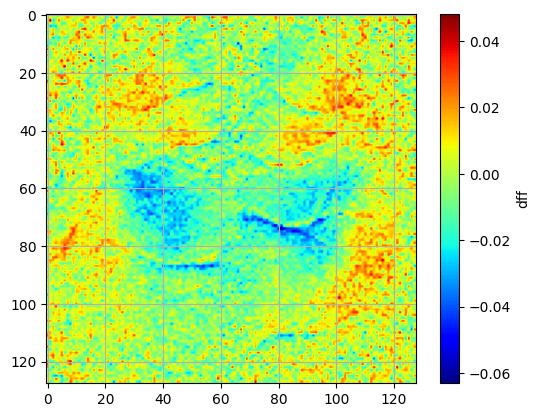

In [23]:
#plot of spatial signal without spatial smoothing
non_smoothed = plot_frame(dff_signal, frame_number, cmap = "jet", color_label = "dff")

#### 6A.2: spatial smoothing applied (gaussian, 3 pixels)

  0%|                                                                                          | 0/128 [00:00<?, ?it/s]

  1%|▋                                                                                 | 1/128 [00:00<00:48,  2.64it/s]

  2%|█▎                                                                                | 2/128 [00:00<00:44,  2.80it/s]

  2%|█▉                                                                                | 3/128 [00:01<00:41,  2.99it/s]

  3%|██▌                                                                               | 4/128 [00:01<00:39,  3.14it/s]

  4%|███▏                                                                              | 5/128 [00:01<00:37,  3.26it/s]

  5%|███▊                                                                              | 6/128 [00:01<00:36,  3.30it/s]

  5%|████▍                                                                             | 7/128 [00:02<00:37,  3.21it/s]

  6%|█████▏                                                                            | 8/128 [00:02<00:38,  3.09it/s]

  7%|█████▊                                                                            | 9/128 [00:02<00:38,  3.11it/s]

  8%|██████▎                                                                          | 10/128 [00:03<00:36,  3.20it/s]

  9%|██████▉                                                                          | 11/128 [00:03<00:36,  3.18it/s]

  9%|███████▌                                                                         | 12/128 [00:03<00:35,  3.23it/s]

 10%|████████▏                                                                        | 13/128 [00:04<00:35,  3.28it/s]

 11%|████████▊                                                                        | 14/128 [00:04<00:35,  3.25it/s]

 12%|█████████▍                                                                       | 15/128 [00:04<00:34,  3.25it/s]

 12%|██████████▏                                                                      | 16/128 [00:05<00:35,  3.19it/s]

 13%|██████████▊                                                                      | 17/128 [00:05<00:34,  3.19it/s]

 14%|███████████▍                                                                     | 18/128 [00:05<00:34,  3.21it/s]

 15%|████████████                                                                     | 19/128 [00:05<00:32,  3.31it/s]

 16%|████████████▋                                                                    | 20/128 [00:06<00:31,  3.41it/s]

 16%|█████████████▎                                                                   | 21/128 [00:06<00:31,  3.38it/s]

 17%|█████████████▉                                                                   | 22/128 [00:06<00:32,  3.31it/s]

 18%|██████████████▌                                                                  | 23/128 [00:07<00:31,  3.34it/s]

 19%|███████████████▏                                                                 | 24/128 [00:07<00:33,  3.08it/s]

 20%|███████████████▊                                                                 | 25/128 [00:07<00:33,  3.11it/s]

 20%|████████████████▍                                                                | 26/128 [00:08<00:32,  3.17it/s]

 21%|█████████████████                                                                | 27/128 [00:08<00:31,  3.23it/s]

 22%|█████████████████▋                                                               | 28/128 [00:08<00:29,  3.36it/s]

 23%|██████████████████▎                                                              | 29/128 [00:08<00:28,  3.42it/s]

 23%|██████████████████▉                                                              | 30/128 [00:09<00:28,  3.38it/s]

 24%|███████████████████▌                                                             | 31/128 [00:09<00:27,  3.47it/s]

 25%|████████████████████▎                                                            | 32/128 [00:09<00:29,  3.23it/s]

 26%|████████████████████▉                                                            | 33/128 [00:10<00:29,  3.25it/s]

 27%|█████████████████████▌                                                           | 34/128 [00:10<00:29,  3.23it/s]

 27%|██████████████████████▏                                                          | 35/128 [00:10<00:28,  3.24it/s]

 28%|██████████████████████▊                                                          | 36/128 [00:11<00:27,  3.31it/s]

 29%|███████████████████████▍                                                         | 37/128 [00:11<00:28,  3.19it/s]

 30%|████████████████████████                                                         | 38/128 [00:11<00:28,  3.16it/s]

 30%|████████████████████████▋                                                        | 39/128 [00:12<00:27,  3.25it/s]

 31%|█████████████████████████▎                                                       | 40/128 [00:12<00:28,  3.10it/s]

 32%|█████████████████████████▉                                                       | 41/128 [00:12<00:27,  3.16it/s]

 33%|██████████████████████████▌                                                      | 42/128 [00:13<00:27,  3.08it/s]

 34%|███████████████████████████▏                                                     | 43/128 [00:13<00:26,  3.15it/s]

 34%|███████████████████████████▊                                                     | 44/128 [00:13<00:26,  3.17it/s]

 35%|████████████████████████████▍                                                    | 45/128 [00:13<00:25,  3.30it/s]

 36%|█████████████████████████████                                                    | 46/128 [00:14<00:25,  3.17it/s]

 37%|█████████████████████████████▋                                                   | 47/128 [00:14<00:24,  3.29it/s]

 38%|██████████████████████████████▍                                                  | 48/128 [00:14<00:25,  3.18it/s]

 38%|███████████████████████████████                                                  | 49/128 [00:15<00:24,  3.19it/s]

 39%|███████████████████████████████▋                                                 | 50/128 [00:15<00:24,  3.18it/s]

 40%|████████████████████████████████▎                                                | 51/128 [00:15<00:22,  3.36it/s]

 41%|████████████████████████████████▉                                                | 52/128 [00:16<00:22,  3.41it/s]

 41%|█████████████████████████████████▌                                               | 53/128 [00:16<00:21,  3.45it/s]

 42%|██████████████████████████████████▏                                              | 54/128 [00:16<00:21,  3.43it/s]

 43%|██████████████████████████████████▊                                              | 55/128 [00:16<00:21,  3.43it/s]

 44%|███████████████████████████████████▍                                             | 56/128 [00:17<00:22,  3.26it/s]

 45%|████████████████████████████████████                                             | 57/128 [00:17<00:21,  3.38it/s]

 45%|████████████████████████████████████▋                                            | 58/128 [00:17<00:20,  3.34it/s]

 46%|█████████████████████████████████████▎                                           | 59/128 [00:18<00:20,  3.31it/s]

 47%|█████████████████████████████████████▉                                           | 60/128 [00:18<00:20,  3.30it/s]

 48%|██████████████████████████████████████▌                                          | 61/128 [00:18<00:19,  3.36it/s]

 48%|███████████████████████████████████████▏                                         | 62/128 [00:19<00:19,  3.36it/s]

 49%|███████████████████████████████████████▊                                         | 63/128 [00:19<00:19,  3.37it/s]

 50%|████████████████████████████████████████▌                                        | 64/128 [00:19<00:19,  3.24it/s]

 51%|█████████████████████████████████████████▏                                       | 65/128 [00:19<00:19,  3.31it/s]

 52%|█████████████████████████████████████████▊                                       | 66/128 [00:20<00:18,  3.39it/s]

 52%|██████████████████████████████████████████▍                                      | 67/128 [00:20<00:17,  3.51it/s]

 53%|███████████████████████████████████████████                                      | 68/128 [00:20<00:17,  3.36it/s]

 54%|███████████████████████████████████████████▋                                     | 69/128 [00:21<00:17,  3.45it/s]

 55%|████████████████████████████████████████████▎                                    | 70/128 [00:21<00:17,  3.39it/s]

 55%|████████████████████████████████████████████▉                                    | 71/128 [00:21<00:17,  3.35it/s]

 56%|█████████████████████████████████████████████▌                                   | 72/128 [00:22<00:17,  3.18it/s]

 57%|██████████████████████████████████████████████▏                                  | 73/128 [00:22<00:16,  3.27it/s]

 58%|██████████████████████████████████████████████▊                                  | 74/128 [00:22<00:15,  3.40it/s]

 59%|███████████████████████████████████████████████▍                                 | 75/128 [00:22<00:15,  3.32it/s]

 59%|████████████████████████████████████████████████                                 | 76/128 [00:23<00:15,  3.42it/s]

 60%|████████████████████████████████████████████████▋                                | 77/128 [00:23<00:14,  3.50it/s]

 61%|█████████████████████████████████████████████████▎                               | 78/128 [00:23<00:14,  3.46it/s]

 62%|█████████████████████████████████████████████████▉                               | 79/128 [00:24<00:13,  3.55it/s]

 62%|██████████████████████████████████████████████████▋                              | 80/128 [00:24<00:14,  3.29it/s]

 63%|███████████████████████████████████████████████████▎                             | 81/128 [00:24<00:14,  3.28it/s]

 64%|███████████████████████████████████████████████████▉                             | 82/128 [00:25<00:14,  3.20it/s]

 65%|████████████████████████████████████████████████████▌                            | 83/128 [00:25<00:13,  3.25it/s]

 66%|█████████████████████████████████████████████████████▏                           | 84/128 [00:25<00:13,  3.30it/s]

 66%|█████████████████████████████████████████████████████▊                           | 85/128 [00:25<00:13,  3.19it/s]

 67%|██████████████████████████████████████████████████████▍                          | 86/128 [00:26<00:12,  3.26it/s]

 68%|███████████████████████████████████████████████████████                          | 87/128 [00:26<00:12,  3.29it/s]

 69%|███████████████████████████████████████████████████████▋                         | 88/128 [00:26<00:12,  3.18it/s]

 70%|████████████████████████████████████████████████████████▎                        | 89/128 [00:27<00:12,  3.12it/s]

 70%|████████████████████████████████████████████████████████▉                        | 90/128 [00:27<00:12,  3.11it/s]

 71%|█████████████████████████████████████████████████████████▌                       | 91/128 [00:27<00:11,  3.16it/s]

 72%|██████████████████████████████████████████████████████████▏                      | 92/128 [00:28<00:11,  3.18it/s]

 73%|██████████████████████████████████████████████████████████▊                      | 93/128 [00:28<00:11,  3.17it/s]

 73%|███████████████████████████████████████████████████████████▍                     | 94/128 [00:28<00:10,  3.23it/s]

 74%|████████████████████████████████████████████████████████████                     | 95/128 [00:29<00:10,  3.23it/s]

 75%|████████████████████████████████████████████████████████████▊                    | 96/128 [00:29<00:10,  3.18it/s]

 76%|█████████████████████████████████████████████████████████████▍                   | 97/128 [00:29<00:09,  3.34it/s]

 77%|██████████████████████████████████████████████████████████████                   | 98/128 [00:30<00:09,  3.28it/s]

 77%|██████████████████████████████████████████████████████████████▋                  | 99/128 [00:30<00:08,  3.27it/s]

 78%|██████████████████████████████████████████████████████████████▌                 | 100/128 [00:30<00:08,  3.37it/s]

 79%|███████████████████████████████████████████████████████████████▏                | 101/128 [00:30<00:08,  3.35it/s]

 80%|███████████████████████████████████████████████████████████████▊                | 102/128 [00:31<00:07,  3.33it/s]

 80%|████████████████████████████████████████████████████████████████▍               | 103/128 [00:31<00:07,  3.34it/s]

 81%|█████████████████████████████████████████████████████████████████               | 104/128 [00:31<00:07,  3.23it/s]

 82%|█████████████████████████████████████████████████████████████████▋              | 105/128 [00:32<00:06,  3.40it/s]

 83%|██████████████████████████████████████████████████████████████████▎             | 106/128 [00:32<00:06,  3.52it/s]

 84%|██████████████████████████████████████████████████████████████████▉             | 107/128 [00:32<00:06,  3.35it/s]

 84%|███████████████████████████████████████████████████████████████████▌            | 108/128 [00:33<00:06,  3.30it/s]

 85%|████████████████████████████████████████████████████████████████████▏           | 109/128 [00:33<00:05,  3.35it/s]

 86%|████████████████████████████████████████████████████████████████████▊           | 110/128 [00:33<00:05,  3.35it/s]

 87%|█████████████████████████████████████████████████████████████████████▍          | 111/128 [00:33<00:05,  3.17it/s]

 88%|██████████████████████████████████████████████████████████████████████          | 112/128 [00:34<00:05,  3.04it/s]

 88%|██████████████████████████████████████████████████████████████████████▋         | 113/128 [00:34<00:04,  3.07it/s]

 89%|███████████████████████████████████████████████████████████████████████▎        | 114/128 [00:34<00:04,  3.21it/s]

 90%|███████████████████████████████████████████████████████████████████████▉        | 115/128 [00:35<00:03,  3.34it/s]

 91%|████████████████████████████████████████████████████████████████████████▌       | 116/128 [00:35<00:03,  3.37it/s]

 91%|█████████████████████████████████████████████████████████████████████████▏      | 117/128 [00:35<00:03,  3.38it/s]

 92%|█████████████████████████████████████████████████████████████████████████▊      | 118/128 [00:36<00:02,  3.46it/s]

 93%|██████████████████████████████████████████████████████████████████████████▍     | 119/128 [00:36<00:02,  3.53it/s]

 94%|███████████████████████████████████████████████████████████████████████████     | 120/128 [00:36<00:02,  3.28it/s]

 95%|███████████████████████████████████████████████████████████████████████████▋    | 121/128 [00:36<00:02,  3.30it/s]

 95%|████████████████████████████████████████████████████████████████████████████▎   | 122/128 [00:37<00:01,  3.30it/s]

 96%|████████████████████████████████████████████████████████████████████████████▉   | 123/128 [00:37<00:01,  3.32it/s]

 97%|█████████████████████████████████████████████████████████████████████████████▌  | 124/128 [00:37<00:01,  3.31it/s]

 98%|██████████████████████████████████████████████████████████████████████████████▏ | 125/128 [00:38<00:00,  3.46it/s]

 98%|██████████████████████████████████████████████████████████████████████████████▊ | 126/128 [00:38<00:00,  3.45it/s]

 99%|███████████████████████████████████████████████████████████████████████████████▍| 127/128 [00:38<00:00,  3.46it/s]

100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:39<00:00,  3.11it/s]

100%|████████████████████████████████████████████████████████████████████████████████| 128/128 [00:39<00:00,  3.27it/s]

frame number 200 plotted


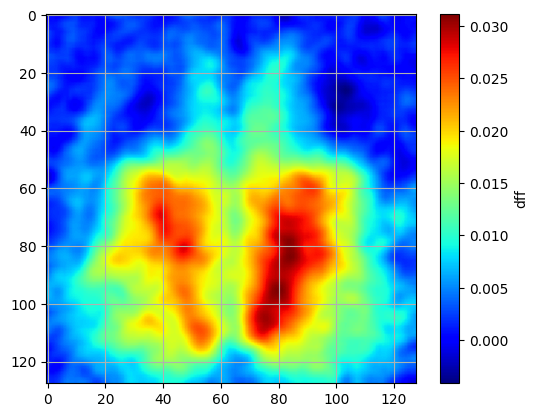

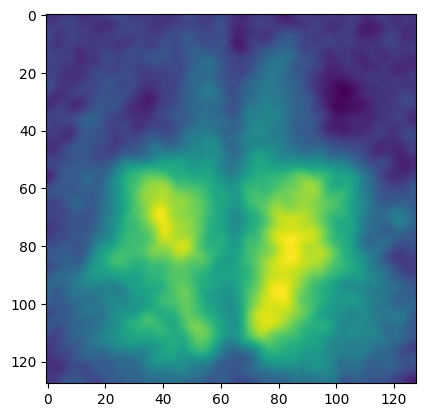

In [24]:
#plot of spatial resolution including spatial smoothing
smoothed_signal = smoothing(dff_signal)
plot_frame(smoothed_signal, 200, cmap = "jet", color_label = "dff")
plt.imshow(smoothed_signal[201])

### 6B: Temporal filtering

dff plot with chebyshev type 1 temporal filtering (high and low bandpass filter)

In [25]:
interactive_plot(smoothed_signal.mean(axis=(1,2)), title_label = "temporally smoothed signal", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 7: ROI plotting

### 7A: ROI full frame

plotting single flash full frame mean

In [26]:
full_roi_single, full_single_segments = avg_trials(single_indices, smoothed_signal, double=False, segment_size=200, minus=20)

In [27]:
interactive_plot(full_roi_single.mean(axis=(1,2)), title_label = "full frame single average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting double flash full frame mean

In [28]:
full_roi_double, full_double_segments = avg_trials(double_indices, smoothed_signal, double=True, segment_size=200, minus=20)

In [29]:
interactive_plot(full_roi_double.mean(axis=(1,2)), title_label = "full frame double average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting NOGO full frame mean

Need to import the text file to know the location of the nogo trials

In [30]:
txt_path = f"X:/RaymondLab/1_Kai/2_Pi_data/{cohort}/{cageID}/stage2_{cageID}_{mouseID}/lick_rates/{session}_data.txt"
txt_file = load_txt(txt_path, fps=30, footer = 4)

successfully loaded txt file


In [31]:
nogo_trials = extract_nogo(txt_file)

# nogo trials: 26


plotting nogo trials

In [32]:
full_roi_nogo, full_nogo_segments = avg_trials(nogo_trials, smoothed_signal, double=False, segment_size=200, minus=20)

In [33]:
interactive_plot(full_roi_nogo.mean(axis=(1,2)), title_label = "full frame NOGO average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

### 7B: V1 ROI

within all of v1 area at the back of the cortex the peak value at 5 frames is taken as the central point and a 15x15 grid is placed around the peak value

plotting single flash just v1 10x10 mean

In [34]:
v1_area_single = extract_v1(full_roi_single, roi_time = 5, roi_start_x=15, roi_start_y = 85, roi_width=45, roi_height = 45)

In [35]:
interactive_plot(v1_area_single.mean(axis=(1,2)), title_label = "v1 single average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

plotting double flash just v1 10x10 mean

In [36]:
v1_area_double = extract_v1(full_roi_double, roi_time = 5, roi_start_x=15, roi_start_y = 85, roi_width=45, roi_height = 45)

In [37]:
interactive_plot(v1_area_double.mean(axis=(1,2)), title_label = "v1 double average", xaxis_label = "frame number (30 fps)", yaxis_label = "dff")

## Step 8: Line up to txt file and success vs fail rate

#### Step 8A: load in txt file from Pi_data folder

In [38]:
txt_path = f"X:/RaymondLab/1_Kai/2_Pi_data/{cohort}/{cageID}/stage2_{cageID}_{mouseID}/lick_rates/{session}_data.txt"
txt_file = load_txt(txt_path, fps=30, footer = 4)

#extract single, double or nogo columns from the txt file
single_txt, double_txt, nogo_txt = extract_success(txt_file)

successfully loaded txt file


#### Step 8B: take the dff signal and sort them into arrays based on success or fail

In [39]:
single_success, single_fail = sort_success(single_txt, full_single_segments)

success = 7
fail = 31
total trials = 38


In [40]:
double_success, double_fail = sort_success(double_txt, full_double_segments)

success = 30
fail = 6
total trials = 36


In [41]:
nogo_success, nogo_fail = sort_success(nogo_txt, full_nogo_segments)

success = 10
fail = 16
total trials = 26


## Step 9: Save the 3D array as a TIFF stack

In [42]:
save_tiff(smoothed_signal, tiff_path_full) # full frame whole session tiff stack
save_tiff(full_roi_single, tiff_path_single) #SINGLE flash averaged response over all trials tiff stack file name to save
save_tiff(full_roi_double, tiff_path_double) #DOUBLE flash averaged response over all trials tiff stack file name to save

  0%|                                                                                        | 0/34068 [00:00<?, ?it/s]

  6%|████▌                                                                     | 2129/34068 [00:00<00:01, 21195.47it/s]

 14%|██████████▎                                                               | 4743/34068 [00:00<00:01, 23974.05it/s]

 21%|███████████████▌                                                          | 7140/34068 [00:00<00:01, 22637.56it/s]

 28%|████████████████████▍                                                     | 9412/34068 [00:00<00:01, 20076.41it/s]

 34%|████████████████████████▌                                                | 11470/34068 [00:00<00:01, 20176.65it/s]

 41%|█████████████████████████████▌                                           | 13807/34068 [00:00<00:00, 21122.13it/s]

 47%|██████████████████████████████████▏                                      | 15942/34068 [00:00<00:00, 19444.24it/s]

 53%|██████████████████████████████████████▋                                  | 18060/34068 [00:00<00:00, 19890.77it/s]

 60%|███████████████████████████████████████████▊                             | 20464/34068 [00:00<00:00, 21042.44it/s]

 68%|█████████████████████████████████████████████████▌                       | 23122/34068 [00:01<00:00, 22604.41it/s]

 75%|██████████████████████████████████████████████████████▌                  | 25446/34068 [00:01<00:00, 22727.10it/s]

 82%|███████████████████████████████████████████████████████████▋             | 27881/34068 [00:01<00:00, 23141.07it/s]

 89%|█████████████████████████████████████████████████████████████████▏       | 30422/34068 [00:01<00:00, 23745.74it/s]

 96%|██████████████████████████████████████████████████████████████████████▎  | 32807/34068 [00:01<00:00, 22830.22it/s]

100%|█████████████████████████████████████████████████████████████████████████| 34068/34068 [00:01<00:00, 21840.15it/s]

Combined TIFF stack saved successfully.


  0%|                                                                                          | 0/200 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 200/200 [00:00<00:00, 15198.41it/s]

Combined TIFF stack saved successfully.


  0%|                                                                                          | 0/200 [00:00<?, ?it/s]

100%|█████████████████████████████████████████████████████████████████████████████| 200/200 [00:00<00:00, 20008.13it/s]

Combined TIFF stack saved successfully.


### Step 9B: Pickle for uploading into other scripts

In [43]:
# Now you can use these file paths in your code
with open(pickle_single_v1, 'wb') as f:
    pickle.dump(v1_area_single, f)

with open(pickle_double_v1, 'wb') as f:
    pickle.dump(v1_area_double, f)

with open(pickle_single_success_ff, 'wb') as f:
    pickle.dump(single_success, f)

with open(pickle_single_fail_ff, 'wb') as f:
    pickle.dump(single_fail, f)

with open(pickle_double_success_ff, 'wb') as f:
    pickle.dump(double_success, f)

with open(pickle_double_fail_ff, 'wb') as f:
    pickle.dump(double_fail, f)

with open(pickle_nogo_success_ff, 'wb') as f:
    pickle.dump(nogo_success, f)

with open(pickle_nogo_fail_ff, 'wb') as f:
    pickle.dump(nogo_fail, f)

# Mask and animate figures

#### currently not using these, good for visualization and flair

In [44]:
#masking = load_masks(dff_signal)
#mask, mask_outline = masking[0], masking[1]

#masked_smoothed_signal = smoothed_signal*mask
#masked_full_roi_single = full_roi_single*mask
#masked_full_roi_double = full_roi_double*mask

In [45]:
#file_path_ = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts.tiff"
#save_tiff(masked_smoothed_signal, file_path)

#file_path = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts_avg_single.tiff"
#save_tiff(masked_full_roi_single, file_path)

#file_path = "X:/Raymond Lab/Kaiiiii/processed_data/ #429904_m1_stage2_day2_with_spouts_avg_double.tiff"
#save_tiff(masked_full_roi_double, file_path)

#print(f"TIFF stack saved at: {file_path}")